In [1]:
#fig_save_path = '/data/peer/wallet/Jupyter/2023_Particle_SASP/figures/'
fig_save_path = '/mnt/d/Jupyter_lilac_250608_part/2023_Particle_SASP/figures/'

In [2]:
#DATA_DIR = '/data/peer/wallet/Jupyter/2023_Particle_SASP/data/'
DATA_DIR = '/mnt/d/Jupyter_lilac_250608_part/2023_Particle_SASP/data/'




In [3]:
import numpy as np
import pandas as pd
import scanpy as sc
import anndata
import scipy.sparse as sparse
import matplotlib.pyplot as plt
import seaborn as sns
from kneed import KneeLocator
from scanpy.external.pp import magic





In [4]:
from scrnaseq_preprocessing_utils import *

In [5]:
color_map_clusters_nogrey = ["#FFFF00", "#FF34FF", "#FF4A46", "#008941", "#006FA6", "#A30059", "#7A4900", "#0000A6", "#63FFAC", "#B79762", "#004D43", "#8FB0FF",
 "#809693", "#1B4400", "#4FC601", "#3B5DFF", "#4A3B53", "#FF2F80",
"#61615A", "#BA0900", "#6B7900", "#00C2A0", "#FFAA92", "#FF90C9", "#B903AA", "#D16100",
"#DDEFFF", "#000035", "#7B4F4B", "#A1C299", "#300018", "#0AA6D8", "#013349", "#00846F",
"#372101", "#FFB500", "#C2FFED", "#A079BF", "#CC0744", "#C0B9B2", "#C2FF99", "#001E09",
"#00489C", "#6F0062", "#0CBD66", "#EEC3FF", "#456D75", "#B77B68", "#7A87A1", "#788D66",
"#885578", "#FAD09F", "#FF8A9A", "#D157A0", "#BEC459", "#456648", "#0086ED", "#886F4C",
"#34362D", "#B4A8BD", "#00A6AA", "#452C2C", "#636375", "#A3C8C9", "#FF913F", "#938A81",
"#575329", "#00FECF", "#B05B6F", "#8CD0FF", "#3B9700", "#04F757", "#C8A1A1", "#1E6E00",
"#7900D7", "#A77500", "#6367A9", "#A05837", "#6B002C", "#772600", "#D790FF", "#9B9700",
"#549E79", "#FFF69F", "#201625", "#72418F", "#BC23FF", "#99ADC0", "#3A2465", "#922329",
"#5B4534", "#FDE8DC", "#404E55", "#0089A3", "#CB7E98", "#A4E804", "#324E72", "#6A3A4C"]
blue_red = ['#DE2A1B','#1B2ADE',"#1CE6FF", ]
#scanpy layout
sc.set_figure_params(scanpy=True, dpi=150, dpi_save=150, frameon=False, vector_friendly=True, fontsize=7, figsize=None, color_map=None, format='pdf', facecolor=None, transparent=True, ipython_format='png2x')
sns.set_style('white')
sc.settings.verbosity = 3

In [6]:

batlow_20 = ['#1d2356','#1d2b59',
'#14375e',
'#134460',
'#1c5261',
'#235f5f',
'#396a58',
'#4c714e',
'#607843',
'#757e36',
'#8d8532',
'#a78b30',
'#c49138',
'#dc954d',
'#f09c6a',
'#f8a487',
'#f8aca2',
'#f8b5be',
'#f8c2d9',
'#eecbe1'] 
import random
random.seed(1)
random.shuffle(batlow_20)



# explore data

In [7]:
#adata_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo.h5ad'
adata_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_annotated.h5ad'
adata_save_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_annotated_RTX.h5ad'

metadata_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-sample_metadata.csv'


In [8]:
adata_pretreated = sc.read(adata_save_path)

In [9]:
adata_pretreated

AnnData object with n_obs × n_vars = 97987 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCAF

In [ ]:
len(list(set(adata_pretreated.obs['sampleid'])))

In [ ]:
adata_pretreated[adata_pretreated.obs['Level 1 Annotation']=='Epithelial (malignant)']

In [ ]:
#dotplot
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
genes_plot_clean = ['CXCL9','CXCL10','CXCL11']
genes_plot_clean = [x for x in genes_plot_clean if x in adata_pretreated.var_names]
sc.pl.dotplot(adata_pretreated, genes_plot_clean, groupby='annotation',  standard_scale='var')

In [10]:
metadata_df = pd.read_csv(metadata_path,index_col='patient_ID')
metadata_df

,tissue_type,tissue,pretreated,pretreatment,pretreatment_ICT,pretreatment_CTX,sequencing_technique
patient_ID,,,,,,,
U1,primary,pancreas,False,NaN,False,False,10x_v3
U2,primary,pancreas,False,NaN,False,False,10x_v3
U3,primary,pancreas,False,NaN,False,False,10x_v3
U4,primary,pancreas,False,NaN,False,False,10x_v2
U5,primary,pancreas,False,NaN,False,False,10x_v3
U6,primary,pancreas,False,NaN,False,False,10x_v3
U7,primary,pancreas,False,NaN,False,False,10x_v3
U8,primary,pancreas,False,NaN,False,False,10x_v3
U9,primary,pancreas,False,NaN,False,False,10x_v3


In [ ]:
adata = sc.read(adata_path)
adata

In [ ]:
set(adata.obs['annotation'])

In [ ]:
adata = adata[~adata.obs['annotation'].isin(['B-T_doublet'])]
adata

In [ ]:
import cytopus as cp
G = cp.kb.KnowledgeBase()
G.identities.keys()

In [ ]:
#dotplot
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
genes_plot_clean = ['COL3A1','COL1A1','EPCAM','EGFR','CDH1','JAM2','VWF','ESAM','LYVE1']
genes_plot_clean = [x for x in genes_plot_clean if x in adata.var_names]
sc.pl.dotplot(adata, genes_plot_clean, groupby='annotation',  standard_scale='var')

In [ ]:
#less granular annotations

mapping_dict = {'B':'B',
 'B-memory-DN':'B',
 'B-naive':'B',
 'B_proliferating':'B',
 'CD4-T-naive':'CD4-T',
 'CD4-TSCM_TFH':'CD4-T',
 'CD56bright-NK':'CD56bright-NK',
 'CD56dim-NK':'CD56dim-NK',
 'CD8-T':'CD8-T',
 'CD8-TRM':'CD8-T',
 'CD8-T_KLRG1pos-effector':'CD8-T',
 'GC-B':'B',
 'Mac':'Mac',
 'NK':'NK',
 'PV-Mac':'Mac',
 'T':'T',
 'T_proliferating':'T',
 'Treg':'Treg',
 'all_ADM':'epithelial',
 'all_Acinar':'epithelial',
 'all_Acinar (REG+)':'epithelial',
 'all_Adipocyte':'adipocyte',
 'all_Alpha':'endocrine',
 'all_Beta':'endocrine',
 'all_CAF':'(myo)fibroblast',
 'all_Delta':'endocrine',
 'all_Ductal':'epithelial',
 'all_Ductal (atypical)': 'epithelial',
 'all_Epsilon':'endocrine',
 'all_Gamma':'endocrine',
 'all_Hormone-negative neuroendocrine':'neuroendocrine',
 'all_Intra-pancreatic neurons':'neuron',
 'all_Lymphatic':'endo',
 'all_Malignant':'crc-carcinoma-cell',
 'all_Pericyte':'fibroblast',
 'all_Schwann':'schwann',
 'all_Vascular':'endo',
 'all_Vascular smooth muscle':'(myo)fibroblast',
 'all_myCAF':'(myo)fibroblast',
 'c-mono':'mono',
 'cDC1':'DC',
 'cDC2':'DC',
 'cDC3':'DC',
 'gran':'gran',
 'mast':'mast',
 'nc-mono':'mono',
 'p-DC':'DC',
 'plasma':'plasma'}

In [ ]:
adata.obs['annotation_merged']= adata.obs['annotation'].map(mapping_dict)
adata.obs['annotation_merged'].value_counts()

In [ ]:
#remove uncompletely characterized cell types
adata = adata[~adata.obs['annotation_merged'].isin(['T'])]
adata

In [ ]:
adata_pretreated = adata[adata.obs['pretreated']=='True']
adata_pretreated

In [ ]:
number_of_PC_used = calculate_optimal_PC(adata_pretreated, min_PC = 50, min_var=25, n_comps=100, use_hv=None)


In [27]:
sc.pp.neighbors(adata_pretreated, n_neighbors=15, n_pcs=number_of_PC_used)
sc.tl.umap(adata_pretreated)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:34)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:38)


/home/wallet/miniconda3/envs/2022_Peer_SPADE_cellrank2/lib/python3.10/site-packages/anndata/_core/anndata.py:1222: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  df[key] = c


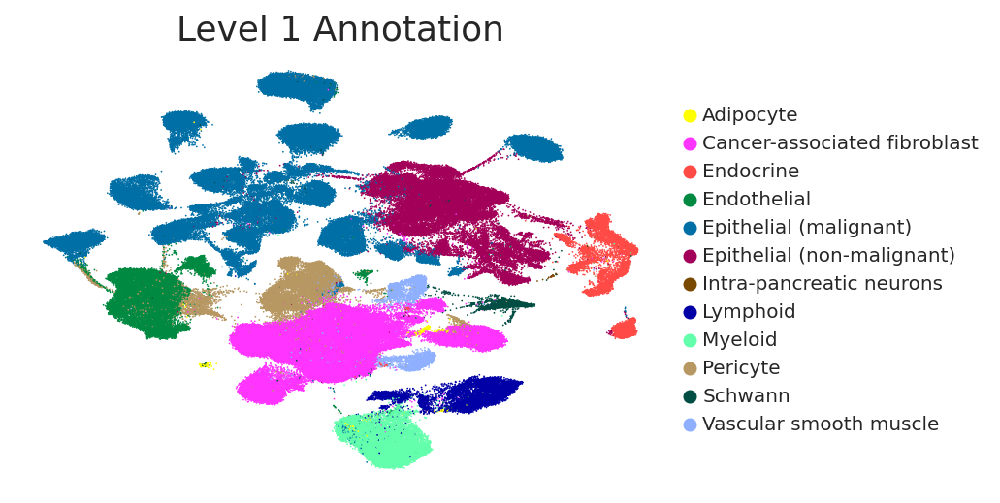

In [28]:
adata = randomize_cells(adata)
sc.pl.umap(adata, color = ['Level 1 Annotation'], s = 3, palette=color_map_clusters_nogrey, legend_fontsize = 10,
           layer='imputed',vmin=0,vmax=1)


In [19]:
data_umap = pd.DataFrame(adata_pretreated.obsm['X_umap'])
data_umap['annotation_merged'] = adata_pretreated.obs['annotation_merged']
data_umap.to_csv(DATA_DIR+'/source_data/Figure_1A.csv')

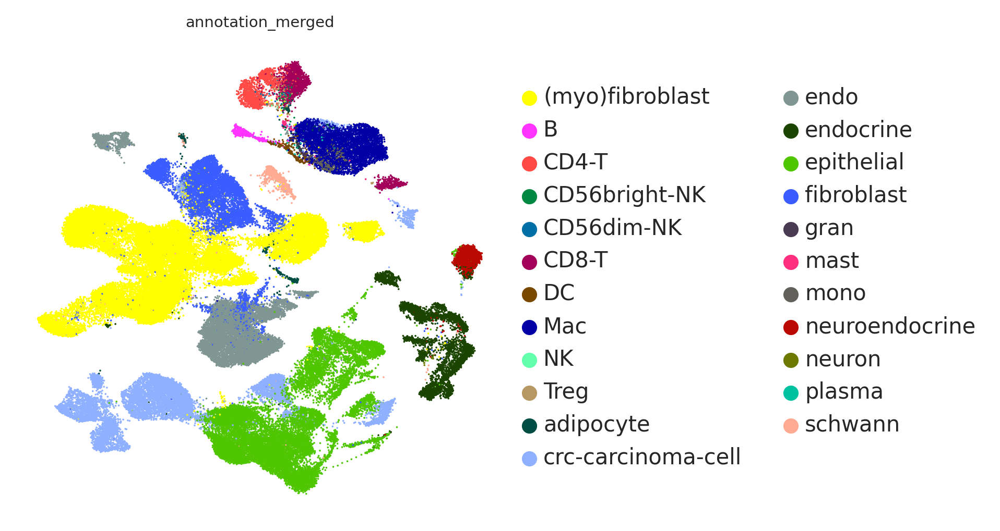

In [11]:
adata = randomize_cells(adata_pretreated)
sc.pl.umap(adata_pretreated, color = ['annotation_merged'], s = 3, palette=color_map_clusters_nogrey, legend_fontsize = 10,
           layer='imputed',vmin=0,vmax=1, save='2022_Hwang_irradiated_annotation_merged_umap.svg')


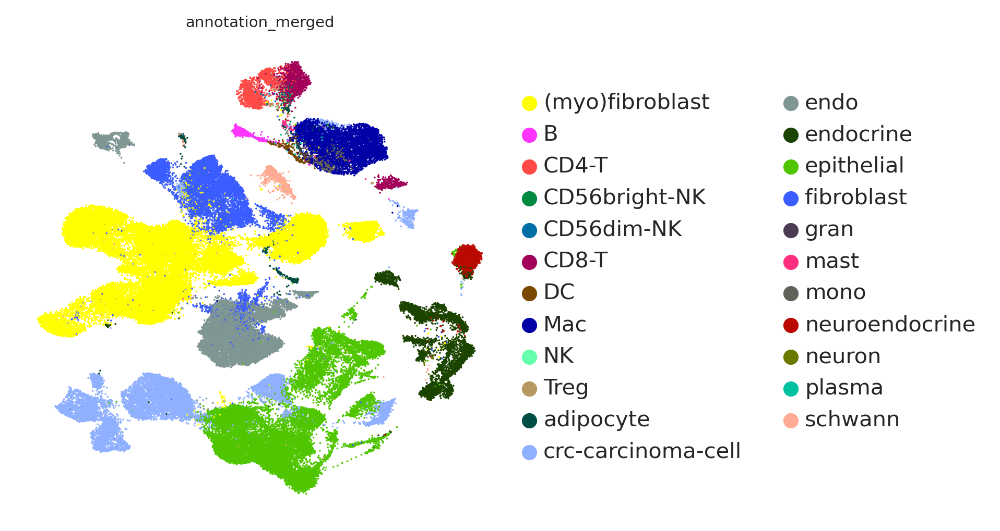

In [24]:
adata = randomize_cells(adata_pretreated)
sc.pl.umap(adata_pretreated, color = ['annotation_merged'], s = 3, palette=color_map_clusters_nogrey, legend_fontsize = 10,
           layer='imputed',vmin=0,vmax=1, save='2022_Hwang_irradiated_annotation_merged_umap.svg')


/home/wallet/miniconda3/envs/2023_scanpy_basic/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:391: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


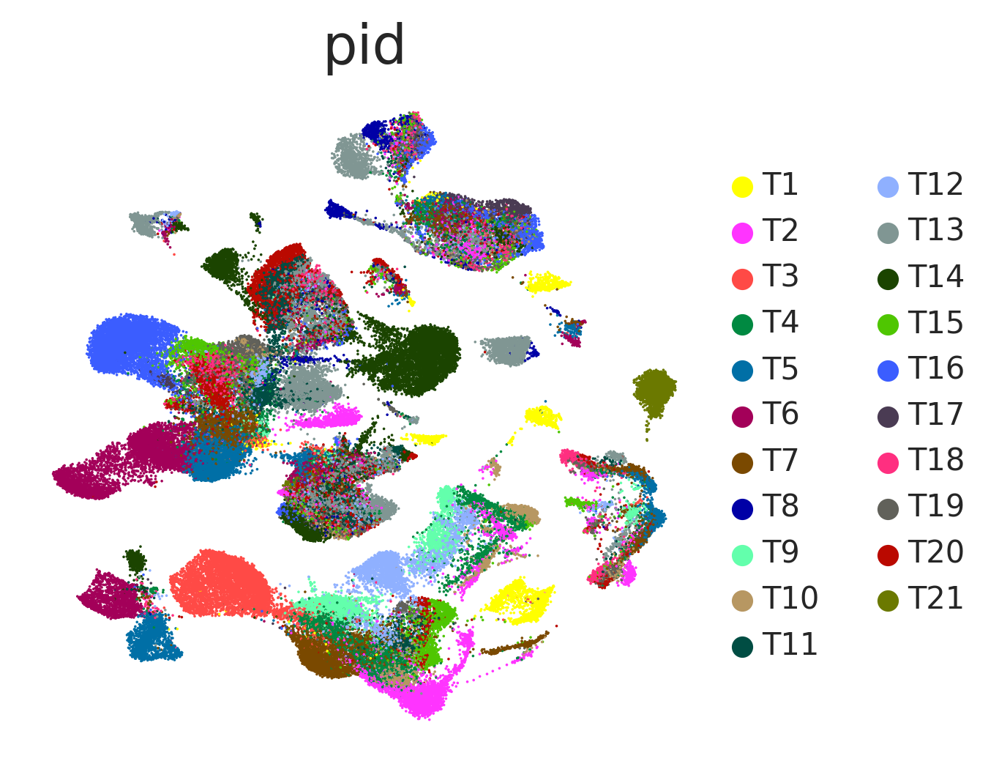

In [40]:
adata = randomize_cells(adata_pretreated)
sc.pl.umap(adata_pretreated, color = ['pid'], s = 3, palette=color_map_clusters_nogrey, legend_fontsize = 10,
           layer='imputed',vmin=0,vmax=1, save='2022_Hwang_irradiated_patients_merged_umap.svg')


In [14]:
set(adata_pretreated.obs['annotation_merged'])

{'(myo)fibroblast',
 'B',
 'CD4-T',
 'CD56bright-NK',
 'CD56dim-NK',
 'CD8-T',
 'DC',
 'Mac',
 'NK',
 'Treg',
 'adipocyte',
 'crc-carcinoma-cell',
 'endo',
 'endocrine',
 'epithelial',
 'fibroblast',
 'gran',
 'mast',
 'mono',
 'neuroendocrine',
 'neuron',
 'plasma',
 'schwann'}

In [15]:
import cytopus as cp
G = cp.kb.KnowledgeBase()

KnowledgeBase object containing 75 cell types and 201 cellular processes



In [16]:
G.identities.keys()

dict_keys(['TCM', 'TSCM', 'CD8-T_KLRG1pos-effector', 'TEM', 'FDC', 'Langerhans', 'B-memory-DN', 'Treg', 'B-memory-non-switched', 'CD56bright-NK', 'mono', 'B-pb-t1', 'NK-adaptive', 'mast', 'TRM', 'CD4-T', 'cDC2', 'p-DC', 'GC-B', 'B-memory-IgM-MZ', 'CD8-T', 'NK', 'T', 'ILC2', 'mo-DC', 'capillary', 'endo-systemic-venous', 'cDC3', 'B', 'gran', 'CD56dim-NK', 'cDC1', 'B-pb-t2', 'Lti', 'plasma', 'B-pb-mature', 'gdT', 'plasma-blast', 'CD8-T-progenitor-exhausted', 'Mac', 'B-memory-switched', 'ILC1', 'ILC3-NCRpos', 'CD8-T_KLRG1neg-effector', 'lung-endo-venous', 'ILC3-NCRneg', 'B-memory', 'endo-aerocyte', 'T-naive', 'B-naive'])

In [17]:
G.identities['mast']

['KIT',
 'TPSB2',
 'ENPP3',
 'MS4A2',
 'TPSD1',
 'PTGDR',
 'GATA2',
 'HDC',
 'IL1RL1',
 'TPSAB1']

In [26]:
cat_order = ['(myo)fibroblast',
 'B',
 'CD4-T',
 'CD56bright-NK',
 'CD56dim-NK',
 'CD8-T',
 'DC',
 'Mac',
 'NK',
 'Treg',
 'adipocyte',
 'crc-carcinoma-cell',
 'endo',
 'endocrine',
 'epithelial',
 'fibroblast',
 'gran',
 'mast',
 'mono',
 'neuroendocrine',
 'neuron',
 'plasma',
 'schwann']

In [22]:
#dotplot
pheno_heat = 'annotation_merged'
marker_genes_filtered = {
 'B':['CD19','CD79A','CD79B'],
                          'plasma':['SDC1','CD38'],
 'CD4-T':['CD3E','CD3D','TRAC','TRBC1','TRBC2','CD4'], 
 'CD8-T':['CD8A','CD8B'],
    'Treg':['FOXP3','CTLA4'],
                          'NK':['NCAM1','NCR1'],
 'CD56bright-NK':['FCGR3A'],
 'CD56dim-NK':['PRF1',],
     'gran':['CSF3R','FCGR3B'],
 'mast':['TPSB2',
 'KIT'],
 'mono':['CD14','ITGAM'],
 'DC':['IRF4','IRF8','IRF7','BATF3','XCR1'],
 'Mac':['MSR1','CD68'],
    'epithelial':['EGFR'],
         'crc-carcinoma-cell':['DUOXA2','MUC1','OLFM4','PRSS1'],
 
    '(myo)fibroblast':['ACTA2','MYH11'],
 'fibroblast':['COL1A1','COL3A1','VIM'],
 'adipocyte':['APOC1','ADIPOQ','PLIN1'],
 'endo':['ESAM','VWF','PLAT'],
    'endocrine':['INS','GCG',],
     'neuroendocrine':['SST'],
 'neuron':['TAC1','CHAT'],
 'schwann':['SOX10','S100B']}
sns.set(font_scale = 1.5)
sns.set_style('white')
#sc.tl.dendrogram(adata_pretreated, groupby=pheno_heat)
sc.pl.dotplot(adata_pretreated, marker_genes_filtered, groupby=pheno_heat, standard_scale='var',
             categories_order=cat_order, save='2022_Hwang_irradiated_patients_celltype_markers.svg')

NameError: name 'cat_order' is not defined

In [24]:
dp = sc.pl.dotplot(adata_pretreated, marker_genes_filtered, groupby=pheno_heat, standard_scale='var',show=False, return_fig=True, 
             )

# Two DataFrames are cached on the DotPlot object
pct_cells = dp.dot_size_df     # % of cells expressing each gene (rows = groups)
mean_expr = dp.dot_color_df    # mean expression used for the colour scale

# Write them out, inspect, etc.
pct_cells.to_csv(DATA_DIR+'/source_data/Figure_S1B_dotplot_fraction_expressing.csv')
mean_expr.to_csv(DATA_DIR+'/source_data/Figure_S1B_dotplot_mean_expression.csv')
print(pct_cells.head())

                     CD19     CD79A     CD79B      SDC1      CD38      CD3E  \
(myo)fibroblast  0.000185  0.000154  0.000154  0.004264  0.011926  0.000556   
B                0.187891  0.066806  0.108559  0.010438  0.229645  0.008351   
CD4-T            0.008730  0.000794  0.015873  0.001587  0.122222  0.131746   
CD56bright-NK    0.000000  0.000000  0.000000  0.000000  0.455696  0.050633   
CD56dim-NK       0.000000  0.000000  0.000000  0.000000  0.300000  0.050000   

                     CD3D      TRAC     TRBC1     TRBC2  ...      ESAM  \
(myo)fibroblast  0.000494  0.001576  0.000649  0.000896  ...  0.001298   
B                0.014614  0.002088  0.008351  0.012526  ...  0.000000   
CD4-T            0.115079  0.102381  0.179365  0.123016  ...  0.000794   
CD56bright-NK    0.012658  0.000000  0.037975  0.037975  ...  0.000000   
CD56dim-NK       0.000000  0.025000  0.100000  0.075000  ...  0.000000   

                      VWF      PLAT  INS       GCG       SST      TAC1  \
(myo)f

In [ ]:
#dotplot
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
genes_plot_clean = ['COL3A1','COL1A1','EPCAM','EGFR','CDH1','JAM2','VWF','ESAM','LYVE1']
genes_plot_clean = [x for x in genes_plot_clean if x in adata.var_names]
sc.pl.dotplot(adata, genes_plot_clean, groupby='annotation',  standard_scale='var')

In [29]:
all_chemokines = ['CCL1',
'CCL11',
'CCL13',
'CCL14',
'CCL15',
'CCL16',
'CCL17',
'CCL18',
'CCL19',
'CCL2',
'CCL20',
'CCL21',
'CCL22',
'CCL23',
'CCL24',
'CCL25',
'CCL26',
'CCL27',
'CCL28',
'CCL3',
'CCL4',
'CCL5',
'CCL7',
'CCL8',
'CX3CL1',
'CXCL1',
'CXCL10',
'CXCL11',
'CXCL12',
'CXCL13',
'CXCL16',
'CXCL2',
'CXCL3',
'CXCL5',
'CXCL6',
'CXCL8',
'CXCL9']

In [30]:
celltypes = ['endo',
 'neuroendocrine',
 'schwann',
 'precursor',
             'neuron',
 'endocrine',
 'fibroblast',
 'adipocyte',
 '(myo)fibroblast',
 'epithelial',
 'crc-carcinoma-cell']

In [31]:
import scipy
adata_pretreated.layers['zscored'] = scipy.stats.zscore(np.array(adata_pretreated.X.todense()),axis=0)

In [32]:
pheno_heat = 'annotation_merged'
genes_plot_clean = [x for x in all_chemokines if x in adata_pretreated.var_names]

plt_df = plt_gene_heatmap_df(adata_pretreated,pheno_heat,genes_plot_clean,cluster_minus_one_present=False, 
                             zscore=True, layer_heat = 'zscored')

Cluster:  endocrine
Cluster:  Mac
Cluster:  plasma
Cluster:  CD4-T
Cluster:  B
Cluster:  fibroblast
Cluster:  gran
Cluster:  DC
Cluster:  neuroendocrine
Cluster:  adipocyte
Cluster:  Treg
Cluster:  neuron
Cluster:  mono
Cluster:  schwann
Cluster:  mast
Cluster:  CD8-T
Cluster:  endo
Cluster:  CD56bright-NK
Cluster:  CD56dim-NK
Cluster:  epithelial
Cluster:  NK
Cluster:  (myo)fibroblast
Cluster:  crc-carcinoma-cell


In [33]:
adata

View of AnnData object with n_obs × n_vars = 97987 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF'

In [34]:
plt_df = plt_df.T[~plt_df.isna().all()].T
plt_df = plt_df[plt_df.index.isin(celltypes)]
plt_df

,CCL22,CXCL11,CXCL12,CCL23,CCL25,CXCL2,CCL20,CCL16,CCL21,CCL26,...,CXCL10,CCL3,CCL24,CXCL16,CXCL8,CCL2,CCL19,CX3CL1,CCL13,CCL17
endocrine,-0.001623,-0.008036,-0.165265,-0.006810,0.006078,-0.174373,-0.054257,-0.043468,-0.074765,-0.015144,...,-0.021730,-0.050480,-0.013785,-0.069714,-0.053540,-0.091536,-0.059774,-0.096789,-0.011147,-0.032657
fibroblast,-0.014073,-0.004395,-0.051669,0.005946,0.033845,-0.141291,-0.049551,-0.015853,-0.022234,0.068805,...,-0.016941,-0.059649,-0.012907,-0.064987,-0.052796,0.141482,0.038190,0.100599,-0.007147,-0.026950
neuroendocrine,-0.002104,-0.006067,-0.165265,0.023048,-0.000426,-0.166751,-0.052013,-0.043468,-0.078764,-0.015457,...,-0.015458,-0.063416,-0.020834,-0.069714,-0.053951,-0.089219,-0.056257,0.046800,-0.011147,-0.015561
adipocyte,-0.023900,-0.018292,-0.119340,-0.021804,0.041578,-0.134890,0.059443,-0.043468,-0.065364,0.055247,...,-0.026284,0.049893,-0.020834,0.081722,0.138835,-0.071420,-0.059774,-0.056037,-0.011147,0.022084
neuron,-0.023900,-0.018292,-0.165265,-0.021804,-0.031556,-0.175890,-0.056184,-0.043468,-0.078764,-0.029925,...,-0.026284,-0.063416,-0.020834,-0.069714,-0.058426,-0.093258,-0.059774,-0.102022,-0.011147,-0.041107
schwann,-0.023900,-0.018292,-0.121158,-0.021804,0.006935,-0.145839,-0.041908,-0.043468,-0.031765,-0.012730,...,-0.026284,-0.063416,-0.020834,-0.063897,-0.058426,0.005084,-0.026413,-0.092080,-0.011147,0.003712
endo,-0.007135,0.010634,0.237063,0.145470,-0.001666,0.225886,0.001787,0.347041,0.110056,-0.020882,...,0.004730,-0.048481,-0.000145,-0.062570,-0.038535,-0.028185,-0.044953,0.262666,-0.000533,-0.016283
epithelial,-0.019366,0.011262,-0.018759,-0.019785,-0.008183,0.216126,-0.015165,-0.036602,-0.078319,-0.021586,...,-0.021858,-0.059717,0.015532,-0.040942,0.092675,0.107596,-0.058760,-0.013003,-0.011147,-0.025634
(myo)fibroblast,-0.016367,-0.007300,0.091484,-0.021804,-0.007949,-0.156248,-0.024129,-0.040975,0.071361,0.012478,...,0.012781,-0.055781,-0.016054,-0.065375,-0.049856,-0.027750,0.083286,-0.094321,0.008510,-0.029155
crc-carcinoma-cell,0.008039,-0.004090,-0.149262,-0.021804,0.019523,0.216985,0.130719,-0.042051,-0.052435,-0.014418,...,0.007050,-0.048635,0.010173,0.150808,0.026927,-0.071840,-0.049334,0.132613,-0.011147,-0.021204


In [35]:
#non imputed
import scipy
%matplotlib inline
save_name = '2022_Hwang_celltypes_chemokines_heatmap.svg'
sns.set(font_scale=2)
clustergrid = sns.clustermap(plt_df, cmap='vlag', col_cluster=True,row_cluster=True, figsize=(60,30), 
                             #row_linkage=plot_df_corr[1],col_linkage=plot_df_corr[2],
                             vmin=-.3,vmax=.3,center=0, z_score=None) 
plt.savefig(fig_save_path+save_name)
print('saved to:',save_name)

saved to: 2022_Hwang_celltypes_chemokines_heatmap.svg


In [36]:
plt_df.to_csv(DATA_DIR+'/source_data/Figure_1B.csv')

In [37]:
plt_df_means = pd.DataFrame(np.mean(plt_df,axis=1))
plt_df_means['celltype'] = plt_df_means.index
plt_df_means

,0,celltype
endocrine,-0.045401,endocrine
fibroblast,-0.015352,fibroblast
neuroendocrine,-0.043201,neuroendocrine
adipocyte,-0.012299,adipocyte
neuron,-0.039328,neuron
schwann,-0.035454,schwann
endo,0.021025,endo
epithelial,0.011498,epithelial
(myo)fibroblast,-0.024213,(myo)fibroblast
crc-carcinoma-cell,0.034284,crc-carcinoma-cell


In [38]:
col_dendro_indices = clustergrid.dendrogram_row.reordered_ind

# Get the original column labels in clustered order
col_labels = plt_df_means.index[col_dendro_indices]
col_labels = list(col_labels)
#col_labels.reverse()


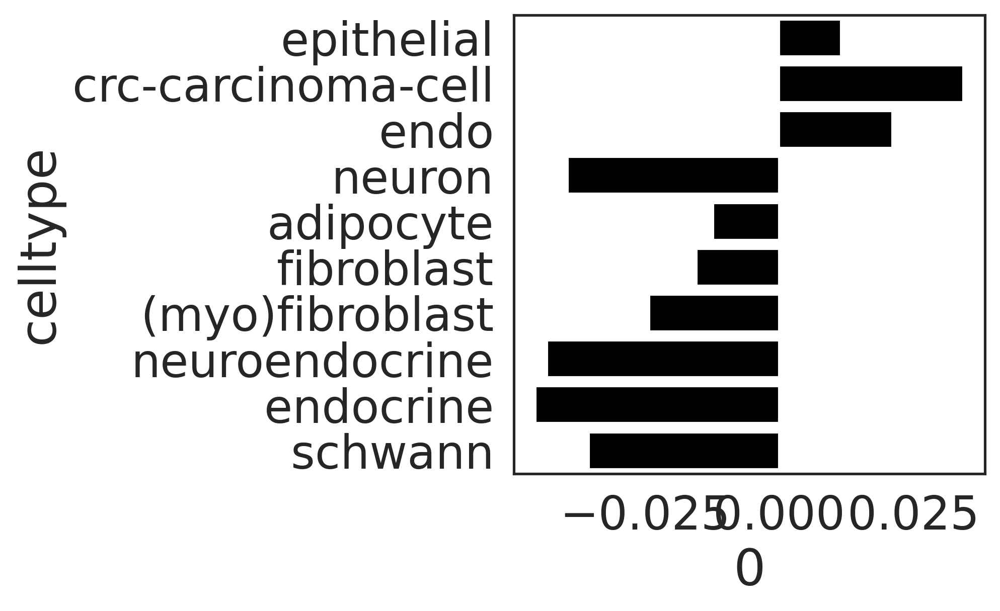

In [39]:
sns.set_style('white')
save_name= 'Carbon_meanzscore_barplot.svg'
sns.barplot(data=plt_df_means, x=0, y='celltype',color='000000',order = col_labels)
plt.savefig(fig_save_path+save_name)

In [40]:
plt_df_means.to_csv(DATA_DIR+'/Figure_1B_bars.csv')

In [41]:
adata.obs[pheno_heat] = pd.Categorical(adata.obs[pheno_heat])

/tmp/ipykernel_265/2415612423.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs[pheno_heat] = pd.Categorical(adata.obs[pheno_heat])


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_annotation_merged']`


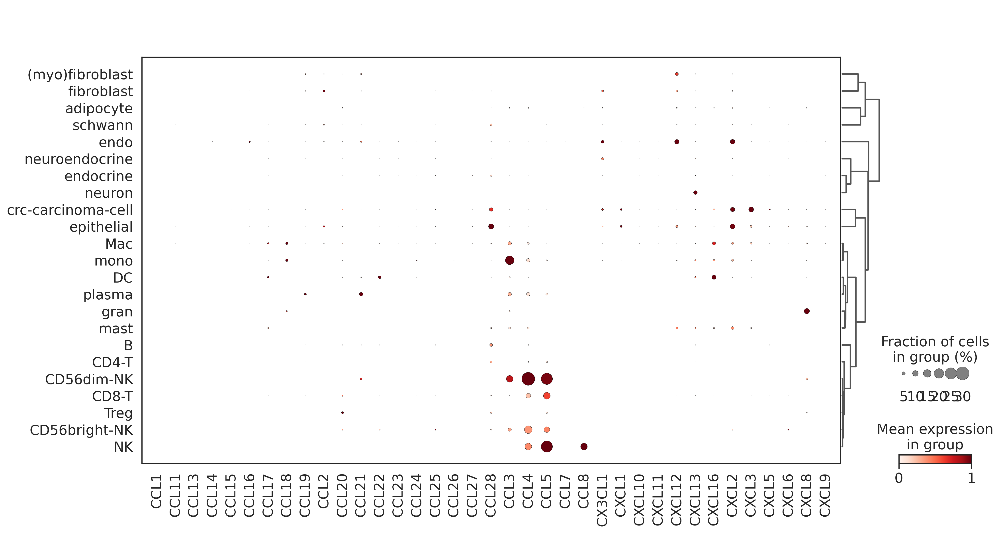

In [42]:
#dotplot
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')




sc.tl.dendrogram(adata, groupby=pheno_heat)
sc.pl.dotplot(adata, genes_plot_clean, groupby=pheno_heat, dendrogram=True, standard_scale='var')

In [153]:
adata_subset = adata_pretreated[adata_pretreated.obs['Level 1 Annotation']=='Epithelial (malignant)']
plot_df_corr = pd.DataFrame(adata_subset[:,all_chemokines].layers['imputed'],index=adata_subset.obs_names,
                                              columns=all_chemokines)
#plot_df_corr =scipy.stats.zscore(plot_df_corr)
plot_df_corr =  corr_cov_matrix_cluster(plot_df_corr,markers=['all_markers'], metric='spearman',
                                        clustering_method = 'average', linkage_distance=1.65)
plot_df_corr

output list order: dataframe, hierarchical flat clusters, row linkage, column linkage


[           CCL11     CCL13     CCL14     CCL15     CCL16     CCL17     CCL18  \
 CCL11   1.000000 -0.003440 -0.001377 -0.007972 -0.004491  0.139905  0.139236   
 CCL13  -0.003440  1.000000 -0.001593 -0.011166 -0.003753  0.198828  0.313411   
 CCL14  -0.001377 -0.001593  1.000000 -0.003377  0.117256 -0.005805 -0.003270   
 CCL15  -0.007972 -0.011166 -0.003377  1.000000 -0.016913  0.147179  0.009099   
 CCL16  -0.004491 -0.003753  0.117256 -0.016913  1.000000 -0.020797 -0.007365   
 CCL17   0.139905  0.198828 -0.005805  0.147179 -0.020797  1.000000  0.168811   
 CCL18   0.139236  0.313411 -0.003270  0.009099 -0.007365  0.168811  1.000000   
 CCL19   0.407456 -0.000345  0.000595 -0.005806 -0.002494  0.055685  0.162789   
 CCL2    0.341155  0.009933  0.127720  0.031747  0.040230  0.079147  0.179486   
 CCL20   0.027390 -0.031299 -0.009079 -0.091730 -0.006311  0.127651 -0.036165   
 CCL21   0.110252  0.000158  0.002667 -0.012496  0.003169  0.013730  0.078932   
 CCL22   0.055684  0.004962 

In [154]:
#correlation imputed cell level
import scipy
%matplotlib inline
sns.set(font_scale=2)
clustergrid = sns.clustermap(plot_df_corr[0], cmap='vlag', col_cluster=True,row_cluster=True, figsize=(60,30), 
                             #row_linkage=plot_df_corr[1],col_linkage=plot_df_corr[2],
                             vmin=-1,vmax=1,center=0,
               z_score=None) 

In [155]:
plot_df_corr[0].to_csv(DATA_DIR + '/source_data/Figure_1C.csv')

In [ ]:
#correlation imputed cell level
save_name = '2022_Hwang_irradiated_cancercell_chemokine_correlation_imputed.svg'
row_colors = [color_map_clusters_nogrey[x] for x in plot_df_corr[1]]
col_colors = [color_map_clusters_nogrey[x] for x in plot_df_corr[1]]
sns.set(font_scale=2)
clustergrid = sns.clustermap(plot_df_corr[0], cmap='vlag',# col_cluster=True,row_cluster=True, 
                             figsize=(60,60), 
                             row_linkage=plot_df_corr[2],col_linkage=plot_df_corr[2],
                             row_colors = row_colors, col_colors=col_colors,
                             vmin=-.6,vmax=.6,center=0,
               z_score=None) 
plt.savefig(fig_save_path+save_name)
print('saved to:',save_name)

saved to: 2022_Hwang_irradiated_cancercell_chemokine_correlation_imputed.svg


### clustering stability

In [ ]:
iter_df = pd.DataFrame(0,columns=all_chemokines,index=all_chemokines)
adata_subset = adata_pretreated[adata_pretreated.obs['Level 1 Annotation']=='Epithelial (malignant)']
iter_list = set(adata_subset.obs['sampleid'])
for i in iter_list:
    adata_subset_leaveoneout = adata_subset[adata_subset.obs['sampleid']!=i]
    plot_df_corr_leaveoneout = pd.DataFrame(adata_subset_leaveoneout[:,all_chemokines].layers['imputed'],index=adata_subset_leaveoneout.obs_names,
                                              columns=all_chemokines)
    #plot_df_corr =scipy.stats.zscore(plot_df_corr)
    plot_df_corr_leaveoneout =  corr_cov_matrix_cluster(plot_df_corr_leaveoneout,markers=['all_markers'], metric='spearman',
                                            clustering_method = 'average', linkage_distance=1.65)
    
    cluster_labels_leaveoneout =plot_df_corr_leaveoneout[1]
    variable_names_leaveoneout =plot_df_corr_leaveoneout[0].index
    # Get the indices of samples in each cluster
    clusters_leaveoneout = np.unique(cluster_labels_leaveoneout)
    cluster_indices_leaveoneout = [np.where(cluster_labels_leaveoneout == c)[0] for c in clusters_leaveoneout]
    
    # Get the variable names for each cluster
    cluster_variable_names_crc_leaveoneout = [[variable_names_leaveoneout[i] for i in ci] for ci in cluster_indices_leaveoneout]
    for j in cluster_variable_names_crc_leaveoneout:
        for g in all_chemokines:
            for h in all_chemokines:
                if g in j and h in j:
                    iter_df.loc[g,h] +=1
    print('finished patient',i)

In [ ]:
#correlation imputed cell level
save_name = '2022_Hwang_irradiated_cancercell_chemokine_correlation_clustering_stability.svg'
cluster_color_dict = dict(zip(list(plot_df_corr[0].index), list(plot_df_corr[1])))
row_order = [plot_df_corr[0].index[x] for x in clustergrid.dendrogram_row.reordered_ind] 
col_order = [plot_df_corr[0].columns[x] for x in clustergrid.dendrogram_col.reordered_ind] 
row_colors = [cluster_color_dict[x] for x in row_order]
row_colors = [color_map_clusters_nogrey[x] for x in row_colors]
col_colors = [cluster_color_dict[x] for x in col_order]
col_colors = [color_map_clusters_nogrey[x] for x in col_colors]
df_iter_plot = iter_df/len(iter_list)
df_iter_plot = df_iter_plot.loc[row_order, col_order]
sns.set(font_scale=2)
clustergrid_2 = sns.clustermap(df_iter_plot, cmap='viridis', col_cluster=False,row_cluster=False, 
                             figsize=(60,60), 
                             row_linkage=plot_df_corr[2],col_linkage=plot_df_corr[2],
                             row_colors = row_colors, col_colors=col_colors,
                             vmin=0,vmax=1,
               z_score=None) 
plt.savefig(fig_save_path+save_name)
print('saved to:',save_name)

In [ ]:
df_iter_plot.to_csv(DATA_DIR+'/Figure_S1C_chemokines.csv')

In [147]:
cluster_labels =plot_df_corr[1]
variable_names =plot_df_corr[0].index
# Get the indices of samples in each cluster
clusters = np.unique(cluster_labels)
cluster_indices = [np.where(cluster_labels == c)[0] for c in clusters]

# Get the variable names for each cluster
cluster_variable_names_crc = [[variable_names[i] for i in ci] for ci in cluster_indices]

print(cluster_variable_names_crc)

[['CCL19', 'CCL21', 'CCL4', 'CCL5', 'CXCL10', 'CXCL12', 'CXCL13', 'CXCL9'], ['CXCL2', 'CXCL3'], ['CCL13', 'CCL18', 'CCL3', 'CCL7'], ['CCL14', 'CCL15', 'CCL16', 'CCL17', 'CCL23', 'CCL24', 'CCL25', 'CCL26', 'CCL8'], ['CCL11', 'CCL2', 'CCL20', 'CCL22', 'CCL27', 'CCL28', 'CX3CL1', 'CXCL1', 'CXCL11', 'CXCL16', 'CXCL5', 'CXCL6', 'CXCL8']]


In [148]:
#correlation per module

# get the lower diagonal of the correlation matrix
lower_diag = np.tril(plot_df_corr[0])
np.fill_diagonal(lower_diag, 0)
lower_diag[lower_diag == 0] = np.nan
lower_diagonal_df = pd.DataFrame(lower_diag, index=plot_df_corr[0].index, columns=plot_df_corr[0].columns)

for i,v in enumerate(cluster_variable_names_crc):
    melted_df = pd.melt(lower_diagonal_df.loc[v,v])
    melted_df = melted_df[~melted_df['value'].isna()]
    print('mean for module',i,'is:',np.mean(melted_df['value']))

mean for module 0 is: 0.5855130172573396
mean for module 1 is: 0.8060619803967534
mean for module 2 is: 0.38583536211511144
mean for module 3 is: 0.024361117890653754
mean for module 4 is: 0.15929296135943932


In [149]:
for i,v in enumerate(cluster_variable_names_crc):
    adata_subset.obs['score_crc_'+str(i)] =  list(np.mean(adata_subset[:,v].layers['zscored'],axis=1))
    sc.tl.score_genes(adata_subset, v, ctrl_size=50, gene_pool=None, n_bins=25, score_name='score_crc_nonzscored_'+str(i),
                                      random_state=0, copy=False, use_raw=None)

/tmp/ipykernel_265/4151043302.py:2: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_subset.obs['score_crc_'+str(i)] =  list(np.mean(adata_subset[:,v].layers['zscored'],axis=1))


computing score 'score_crc_nonzscored_0'
    finished: added
    'score_crc_nonzscored_0', score of gene set (adata.obs).
    200 total control genes are used. (0:00:00)
computing score 'score_crc_nonzscored_1'
    finished: added
    'score_crc_nonzscored_1', score of gene set (adata.obs).
    100 total control genes are used. (0:00:00)
computing score 'score_crc_nonzscored_2'
    finished: added
    'score_crc_nonzscored_2', score of gene set (adata.obs).
    150 total control genes are used. (0:00:00)
computing score 'score_crc_nonzscored_3'
    finished: added
    'score_crc_nonzscored_3', score of gene set (adata.obs).
    249 total control genes are used. (0:00:00)
computing score 'score_crc_nonzscored_4'
    finished: added
    'score_crc_nonzscored_4', score of gene set (adata.obs).
    548 total control genes are used. (0:00:00)


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_pid']`


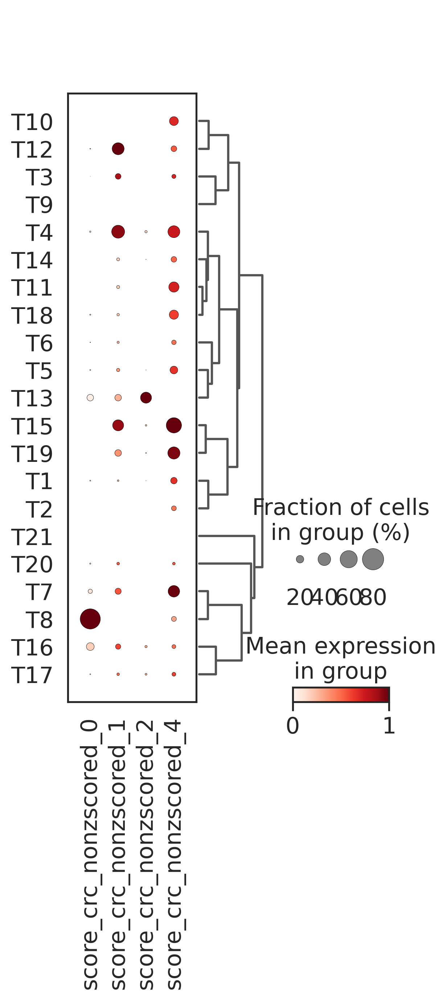

In [150]:
#dotplot
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
plot_list = ['score_crc_nonzscored_0','score_crc_nonzscored_1','score_crc_nonzscored_2','score_crc_nonzscored_4']
sc.tl.dendrogram(adata_subset, groupby='pid')
sc.pl.dotplot(adata_subset, plot_list, groupby='pid', dendrogram=True, standard_scale='var',
             save='Hwang_PDAC_chemokine_modules_dotplot.svg')#dotplot
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
plot_list = ['score_crc_nonzscored_0','score_crc_nonzscored_1','score_crc_nonzscored_2','score_crc_nonzscored_4']
sc.tl.dendrogram(adata_subset, groupby='pid')
sc.pl.dotplot(adata_subset, plot_list, groupby='pid', dendrogram=True, standard_scale='var',
             save='Hwang_PDAC_chemokine_modules_dotplot.svg')

In [152]:
dp = sc.pl.dotplot(adata_subset, plot_list, groupby='pid', standard_scale='var',show=False, return_fig=True, 
             )

# Two DataFrames are cached on the DotPlot object
pct_cells = dp.dot_size_df     # % of cells expressing each gene (rows = groups)
mean_expr = dp.dot_color_df    # mean expression used for the colour scale

# Write them out, inspect, etc.
pct_cells.to_csv(DATA_DIR+'/source_data/Figure_1D_dotplot_fraction_expressing.csv')
mean_expr.to_csv(DATA_DIR+'/source_data/Figure_1D_dotplot_mean_expression.csv')
print(pct_cells.head())

    score_crc_nonzscored_0  score_crc_nonzscored_1  score_crc_nonzscored_2  \
T1                0.013136                0.026273                0.001642   
T2                0.000000                0.000000                0.000000   
T3                0.000822                0.137718                0.000000   
T4                0.021739                0.413043                0.043478   
T5                0.012623                0.066620                0.002104   

    score_crc_nonzscored_4  
T1                0.164204  
T2                0.111111  
T3                0.089825  
T4                0.369565  
T5                0.206872  


    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_pid']`


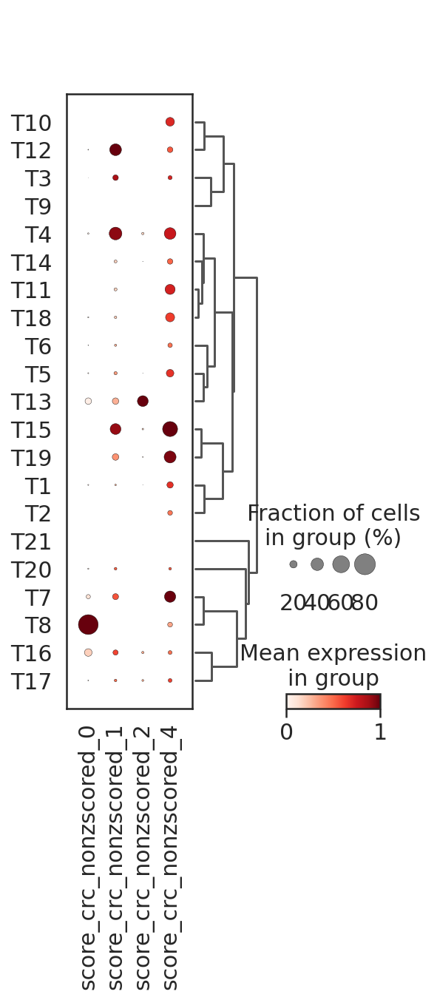

In [214]:
#dotplot
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
plot_list = ['score_crc_nonzscored_0','score_crc_nonzscored_1','score_crc_nonzscored_2','score_crc_nonzscored_4']
sc.tl.dendrogram(adata_subset, groupby='pid')
sc.pl.dotplot(adata_subset, plot_list, groupby='pid', dendrogram=True, standard_scale='var',
             save='Hwang_PDAC_chemokine_modules_dotplot.svg')

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_pid']`


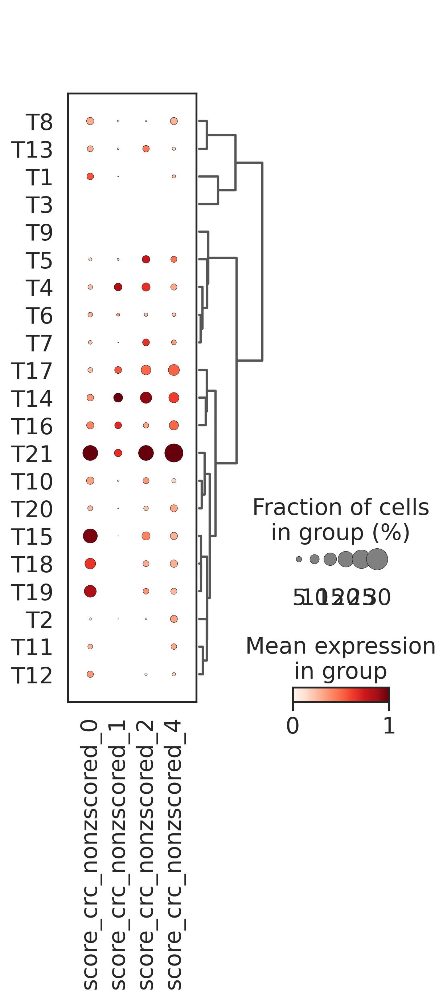

In [135]:
#dotplot
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
plot_list = ['score_crc_nonzscored_0','score_crc_nonzscored_1','score_crc_nonzscored_2','score_crc_nonzscored_4']
sc.tl.dendrogram(adata_subset, groupby='pid')
sc.pl.dotplot(adata_subset, plot_list, groupby='pid', dendrogram=True, standard_scale='var',
             save='Hwang_PDAC_chemokine_modules_dotplot.svg')

In [ ]:
dp = sc.pl.dotplot(adata_subset_plot, receptor_name_ls_scoregenes, groupby='annotation_merged', standard_scale='var',show=False, return_fig=True, 
             )

# Two DataFrames are cached on the DotPlot object
pct_cells = dp.dot_size_df     # % of cells expressing each gene (rows = groups)
mean_expr = dp.dot_color_df    # mean expression used for the colour scale

# Write them out, inspect, etc.
pct_cells.to_csv(DATA_DIR+'/source_data/Figure_1E_dotplot_fraction_expressing.csv')
mean_expr.to_csv(DATA_DIR+'/source_data/Figure_1E_dotplot_mean_expression.csv')
print(pct_cells.head())

In [212]:
#dotplot
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
plot_list = ['score_crc_nonzscored_0','score_crc_nonzscored_1','score_crc_nonzscored_2','score_crc_nonzscored_4']
sc.tl.dendrogram(adata_subset, groupby='pid')
dp=sc.pl.dotplot(adata_subset, plot_list, groupby='pid', dendrogram=True, standard_scale='var',
             save='Hwang_PDAC_chemokine_modules_dotplot.svg',return_fig=True)

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_pid']`


In [216]:
dp.dot_size_df ==0

,score_crc_nonzscored_0,score_crc_nonzscored_1,score_crc_nonzscored_2,score_crc_nonzscored_4
pid,,,,
T1,False,False,False,False
T2,True,True,True,False
T3,False,False,True,False
T4,False,False,False,False
T5,False,False,False,False
T6,False,False,True,False
T7,False,False,True,False
T8,False,True,True,False
T9,True,True,True,True


In [217]:
np.sum((dp.dot_size_df ==0))

score_crc_nonzscored_0     8
score_crc_nonzscored_1     5
score_crc_nonzscored_2    12
score_crc_nonzscored_4     3
dtype: int64

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_pid']`


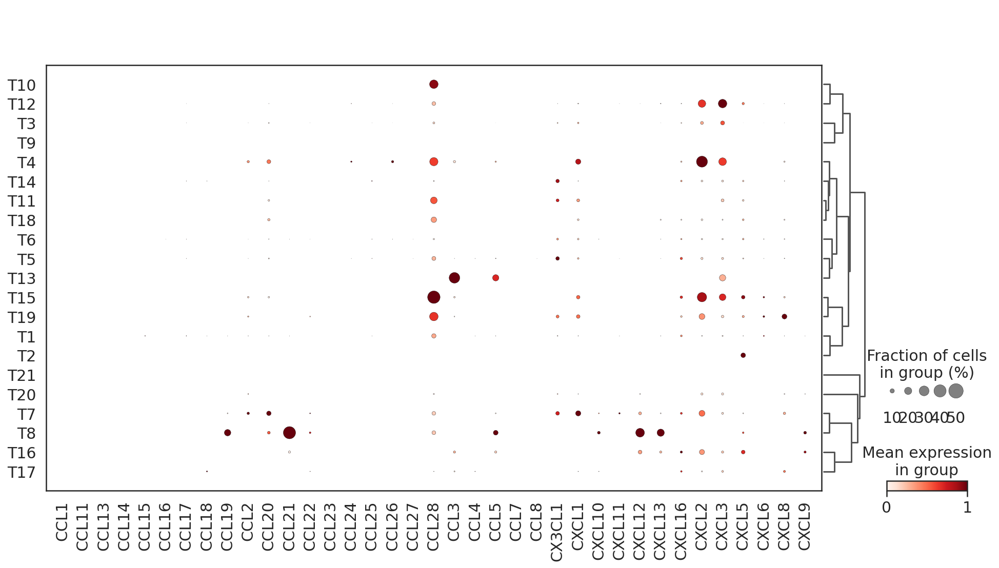

In [215]:
#dotplot
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
sc.tl.dendrogram(adata_subset, groupby='pid')
sc.pl.dotplot(adata_subset, [x for x in all_chemokines if x in adata_subset.var_names], groupby='pid', dendrogram=True, standard_scale='var',
             save='Hwang_PDAC_chemokine_individual_dotplot.svg')

In [54]:
score_list = ['score_crc_0','score_crc_1','score_crc_2','score_crc_3','score_crc_4']
crc_mean_df, crc_frac_df = aggregate_scores(adata_subset,score_list,'pid',
                            zero_cutoff =None,aggregate_function='mean')

In [55]:
score_list = ['score_crc_nonzscored_0','score_crc_nonzscored_1','score_crc_nonzscored_2','score_crc_nonzscored_3','score_crc_nonzscored_4']
crc_mean_df_non_zscored, crc_frac_df_non_zscored = aggregate_scores(adata_subset,score_list,'pid',
                            zero_cutoff =None,aggregate_function='mean')

In [56]:
np.mean(crc_mean_df_non_zscored)

0.03458718

In [57]:
crc_mean_df['pretreated'] = crc_mean_df.index.map(metadata_df['pretreated'].to_dict())
crc_mean_df['pretreated']= crc_mean_df['pretreated'].astype(str)
crc_mean_df

,score_crc_0,score_crc_1,score_crc_2,score_crc_3,score_crc_4,pretreated
T10,-0.065955,-0.148070,-0.030658,-0.026205,0.074151,True
T9,-0.065955,-0.148070,-0.030658,-0.026205,-0.059603,True
T3,-0.063316,0.521993,-0.030658,-0.020627,0.037663,True
T17,-0.017995,0.059389,0.164083,-0.026205,0.070944,True
T1,-0.041297,-0.078481,-0.025523,0.099476,0.063243,True
T4,-0.020780,1.101245,0.035501,0.116900,0.229657,True
T16,0.621439,0.290996,0.139347,-0.026205,0.105583,True
T11,-0.065955,0.020860,-0.030658,-0.026205,0.135065,True
T7,0.176437,0.321273,-0.030658,-0.026205,0.519029,True
T6,-0.046100,-0.018656,-0.030658,-0.005726,0.076225,True


In [58]:
np.mean(crc_mean_df.drop(columns=['pretreated']),axis=0)

score_crc_0    0.124857
score_crc_1    0.194715
score_crc_2    0.026486
score_crc_3   -0.008725
score_crc_4    0.120506
dtype: float32

saved to: Hwang_PDAC_chemokine_modules_score_crc_0.svg


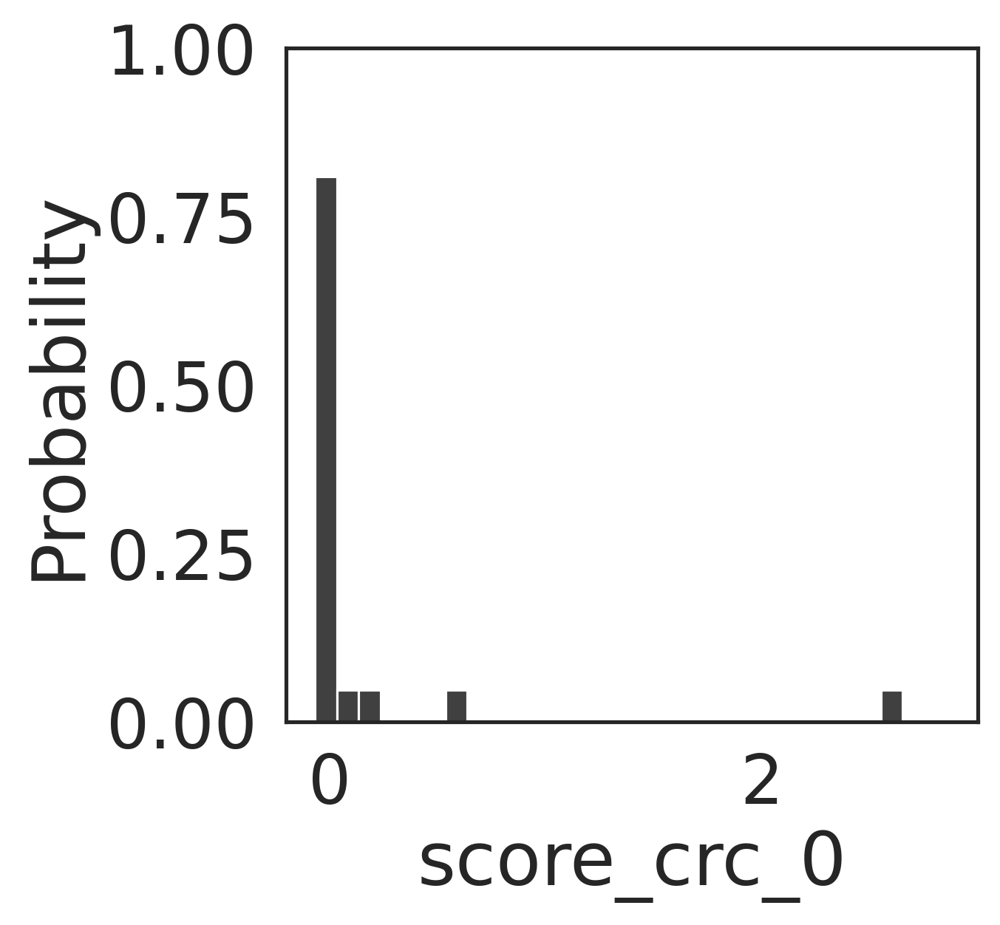

saved to: Hwang_PDAC_chemokine_modules_score_crc_1.svg


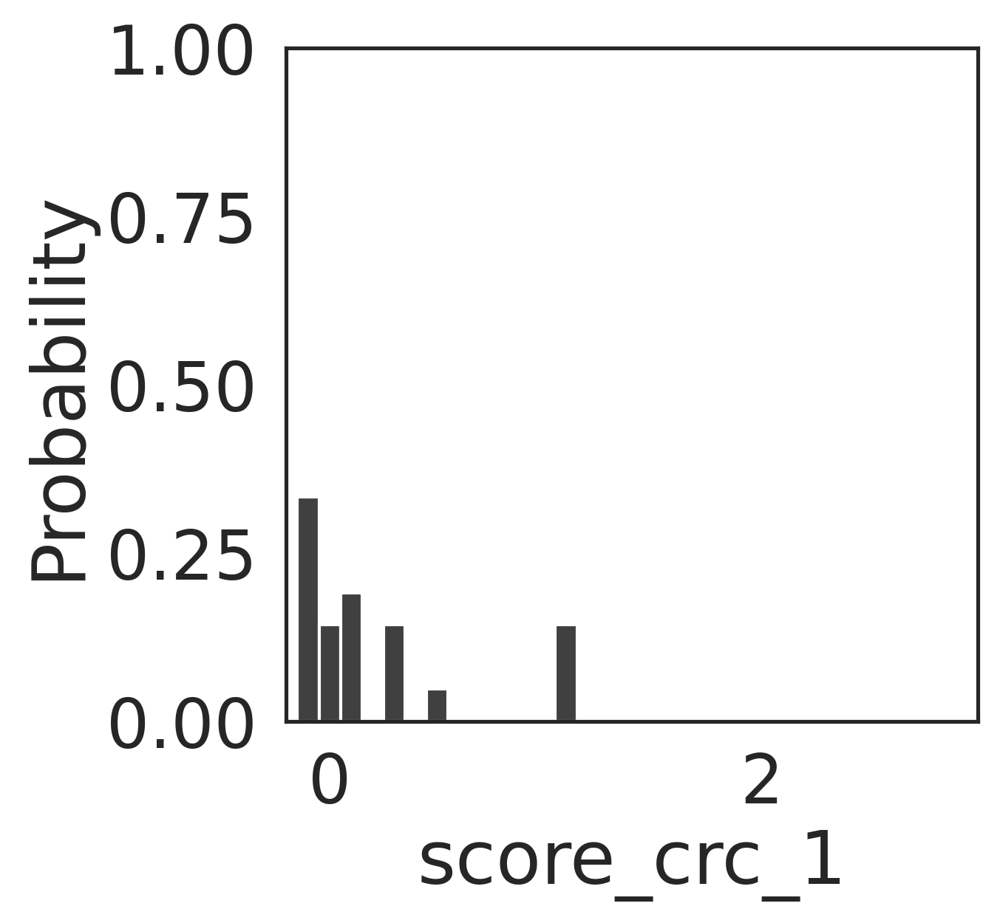

saved to: Hwang_PDAC_chemokine_modules_score_crc_2.svg


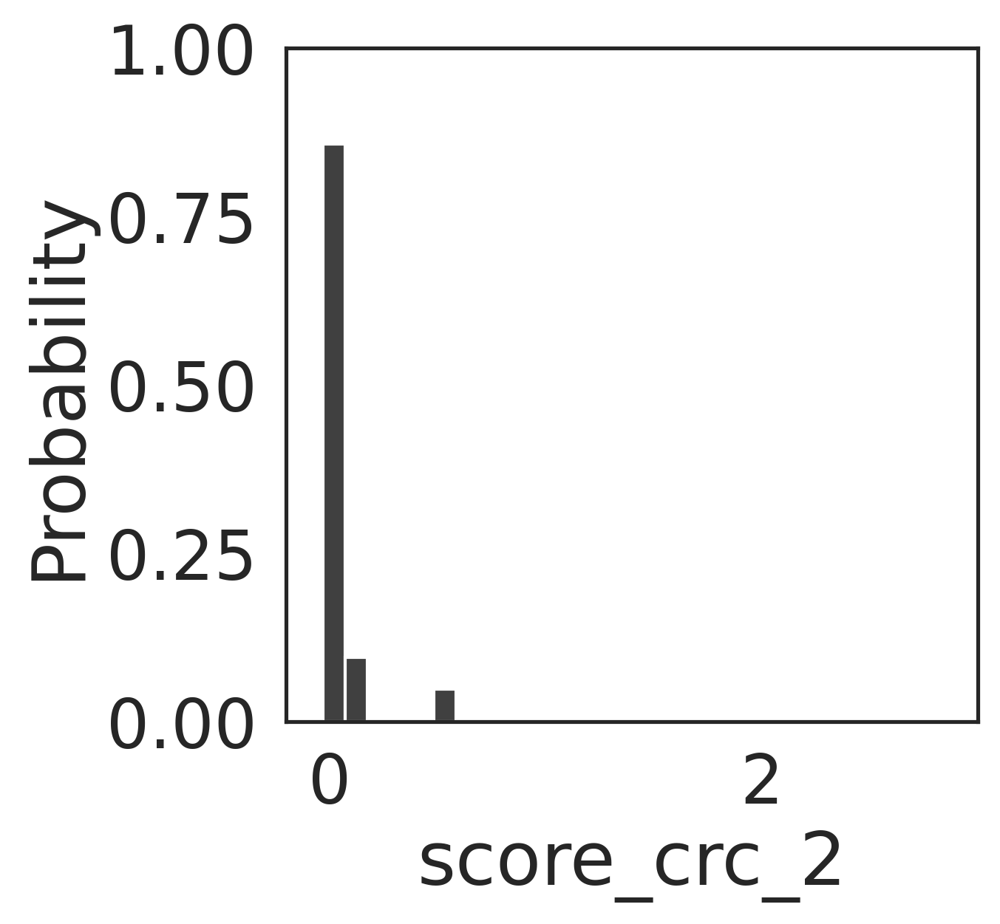

saved to: Hwang_PDAC_chemokine_modules_score_crc_3.svg


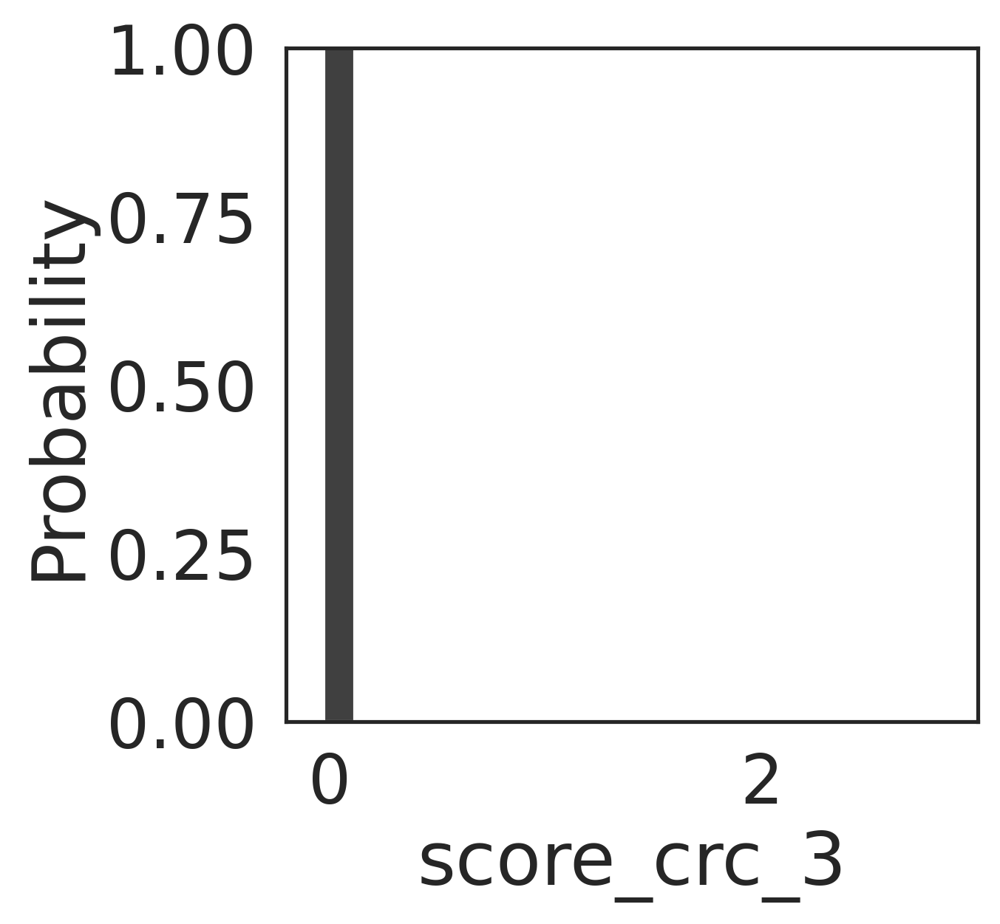

saved to: Hwang_PDAC_chemokine_modules_score_crc_4.svg


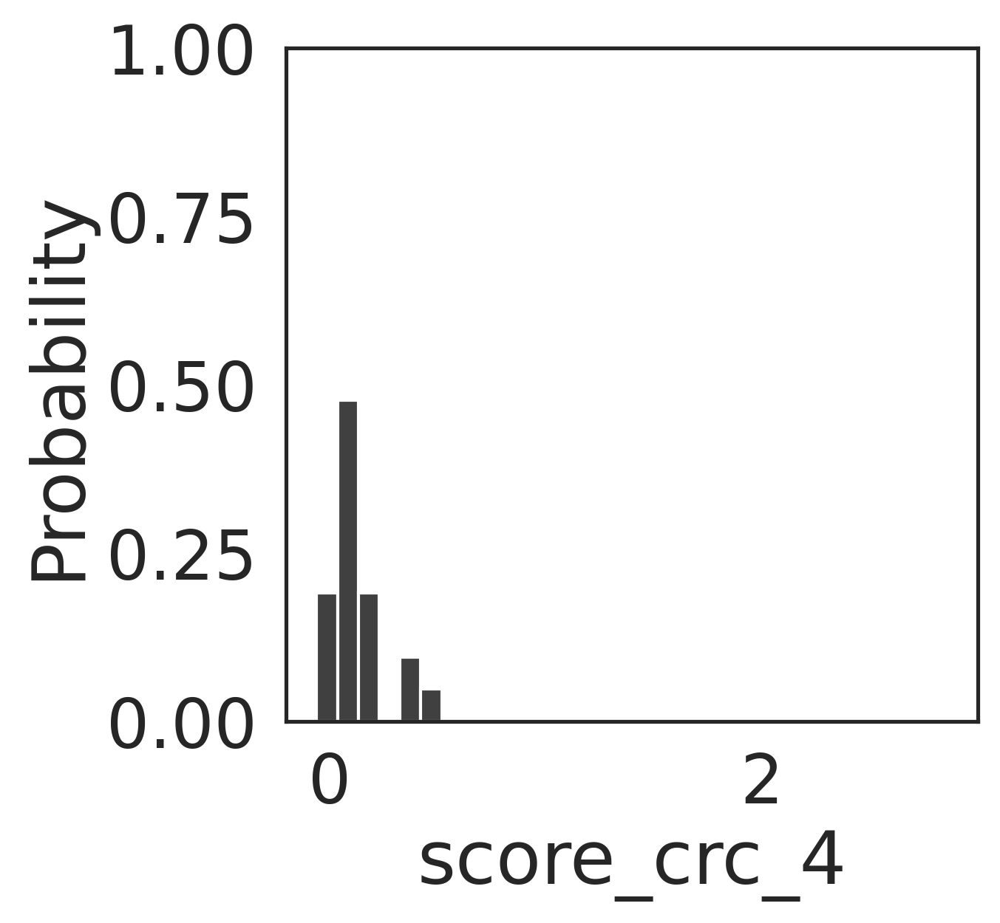

In [59]:
sns.set_style('white')

score_list = ['score_crc_0','score_crc_1','score_crc_2','score_crc_3','score_crc_4']
save_name = 'Hwang_PDAC_chemokine_modules_'

for column in score_list:
    sns.histplot(crc_mean_df[column],binwidth=0.1,
                 color='#000000',stat='probability')
    plt.gca().set(xlim=(-0.2,3))
    plt.gca().set(ylim=(0, 1))
    save_name_full = save_name+column+'.svg'
    plt.savefig(fig_save_path+save_name_full)
    print('saved to:',save_name_full)
    plt.show()
    

In [60]:
crc_mean_df.sort_values('score_crc_0',ascending=False)

,score_crc_0,score_crc_1,score_crc_2,score_crc_3,score_crc_4,pretreated
T8,2.650700,-0.148070,-0.030658,-0.026205,0.200373,True
T16,0.621439,0.290996,0.139347,-0.026205,0.105583,True
T7,0.176437,0.321273,-0.030658,-0.026205,0.519029,True
T13,0.050444,0.081823,0.586802,-0.026205,-0.059603,True
T20,-0.010418,0.052951,-0.030658,-0.026205,-0.020892,True
T17,-0.017995,0.059389,0.164083,-0.026205,0.070944,True
T4,-0.020780,1.101245,0.035501,0.116900,0.229657,True
T1,-0.041297,-0.078481,-0.025523,0.099476,0.063243,True
T6,-0.046100,-0.018656,-0.030658,-0.005726,0.076225,True
T5,-0.048483,0.081122,-0.023599,-0.000585,0.151970,True


In [61]:
#module expression per patient
save_name = '2022_Hwang_irradiated_cancercell_chemokine_modules_per_patient_heatmap.svg'

sns.set(font_scale=2)
clustergrid = sns.clustermap(crc_mean_df.drop(columns=['pretreated']), cmap='vlag',# col_cluster=True,row_cluster=True, 
                             figsize=(60,60), 
                             vmin=-.5,vmax=.5,center=0,
               z_score=None) 
plt.savefig(fig_save_path+save_name)
print('saved to:',save_name)

saved to: 2022_Hwang_irradiated_cancercell_chemokine_modules_per_patient_heatmap.svg


In [62]:
crc_mean_df.sort_values('score_crc_1',ascending=False)

,score_crc_0,score_crc_1,score_crc_2,score_crc_3,score_crc_4,pretreated
T12,-0.051034,1.144470,-0.030658,-0.004614,0.066713,True
T4,-0.020780,1.101245,0.035501,0.116900,0.229657,True
T15,-0.065955,1.058311,0.047752,-0.026205,0.389732,True
T3,-0.063316,0.521993,-0.030658,-0.020627,0.037663,True
T7,0.176437,0.321273,-0.030658,-0.026205,0.519029,True
T16,0.621439,0.290996,0.139347,-0.026205,0.105583,True
T19,-0.065955,0.253983,0.017900,-0.026205,0.362211,True
T13,0.050444,0.081823,0.586802,-0.026205,-0.059603,True
T5,-0.048483,0.081122,-0.023599,-0.000585,0.151970,True
T17,-0.017995,0.059389,0.164083,-0.026205,0.070944,True


In [63]:
crc_mean_df.sort_values('score_crc_1',ascending=False)

,score_crc_0,score_crc_1,score_crc_2,score_crc_3,score_crc_4,pretreated
T12,-0.051034,1.144470,-0.030658,-0.004614,0.066713,True
T4,-0.020780,1.101245,0.035501,0.116900,0.229657,True
T15,-0.065955,1.058311,0.047752,-0.026205,0.389732,True
T3,-0.063316,0.521993,-0.030658,-0.020627,0.037663,True
T7,0.176437,0.321273,-0.030658,-0.026205,0.519029,True
T16,0.621439,0.290996,0.139347,-0.026205,0.105583,True
T19,-0.065955,0.253983,0.017900,-0.026205,0.362211,True
T13,0.050444,0.081823,0.586802,-0.026205,-0.059603,True
T5,-0.048483,0.081122,-0.023599,-0.000585,0.151970,True
T17,-0.017995,0.059389,0.164083,-0.026205,0.070944,True


In [64]:
#T14 T1  T6 T20 T9 T10 T2

In [65]:
crc_mean_df.sort_values('score_crc_2',ascending=False)

,score_crc_0,score_crc_1,score_crc_2,score_crc_3,score_crc_4,pretreated
T13,0.050444,0.081823,0.586802,-0.026205,-0.059603,True
T17,-0.017995,0.059389,0.164083,-0.026205,0.070944,True
T16,0.621439,0.290996,0.139347,-0.026205,0.105583,True
T15,-0.065955,1.058311,0.047752,-0.026205,0.389732,True
T4,-0.020780,1.101245,0.035501,0.116900,0.229657,True
T19,-0.065955,0.253983,0.017900,-0.026205,0.362211,True
T14,-0.065955,-0.002199,-0.018169,-0.001174,0.049316,True
T5,-0.048483,0.081122,-0.023599,-0.000585,0.151970,True
T1,-0.041297,-0.078481,-0.025523,0.099476,0.063243,True
T6,-0.046100,-0.018656,-0.030658,-0.005726,0.076225,True


In [66]:
crc_mean_df.sort_values('score_crc_3',ascending=False)

,score_crc_0,score_crc_1,score_crc_2,score_crc_3,score_crc_4,pretreated
T4,-0.020780,1.101245,0.035501,0.116900,0.229657,True
T1,-0.041297,-0.078481,-0.025523,0.099476,0.063243,True
T5,-0.048483,0.081122,-0.023599,-0.000585,0.151970,True
T14,-0.065955,-0.002199,-0.018169,-0.001174,0.049316,True
T12,-0.051034,1.144470,-0.030658,-0.004614,0.066713,True
T6,-0.046100,-0.018656,-0.030658,-0.005726,0.076225,True
T3,-0.063316,0.521993,-0.030658,-0.020627,0.037663,True
T20,-0.010418,0.052951,-0.030658,-0.026205,-0.020892,True
T19,-0.065955,0.253983,0.017900,-0.026205,0.362211,True
T17,-0.017995,0.059389,0.164083,-0.026205,0.070944,True


In [67]:
crc_mean_df.sort_values('score_crc_4',ascending=False)

,score_crc_0,score_crc_1,score_crc_2,score_crc_3,score_crc_4,pretreated
T7,0.176437,0.321273,-0.030658,-0.026205,0.519029,True
T15,-0.065955,1.058311,0.047752,-0.026205,0.389732,True
T19,-0.065955,0.253983,0.017900,-0.026205,0.362211,True
T4,-0.020780,1.101245,0.035501,0.116900,0.229657,True
T8,2.650700,-0.148070,-0.030658,-0.026205,0.200373,True
T5,-0.048483,0.081122,-0.023599,-0.000585,0.151970,True
T11,-0.065955,0.020860,-0.030658,-0.026205,0.135065,True
T18,-0.049961,-0.059712,-0.030658,-0.026205,0.106853,True
T16,0.621439,0.290996,0.139347,-0.026205,0.105583,True
T2,-0.065955,-0.148070,-0.030658,-0.026205,0.091602,True


In [68]:
def get_proportions(adata, sample_obs, celltype_obs):
    '''
    get cell type proportions from an adata
    adata: adata element containing cell type labels
    sample_obs: key in adata.obs containing sample ids
    patient_obs: key in adata.obs containing patient ids
    comparison_obs: key in adata.obs for additional variable to add to the dataframe
    '''
    try:
        cell_type_df = adata.obs[[sample_obs, celltype_obs]]
    except:
        raise ValueError('obs keys not contained in adata')
    
    #calculate celltype prop. per sample
    proportions_df = pd.DataFrame()
    for i in set(cell_type_df[sample_obs]):
        cell_type_df_sub = cell_type_df[cell_type_df[sample_obs]==i]
        proportions_df[i] = cell_type_df_sub.value_counts(celltype_obs,normalize=True)
    return proportions_df


In [69]:
cell_type_proportions = get_proportions(adata,'pid','annotation_merged').T
cell_type_proportions

annotation_merged,epithelial,endo,(myo)fibroblast,Mac,endocrine,fibroblast,mono,CD8-T,gran,schwann,...,crc-carcinoma-cell,adipocyte,mast,CD56dim-NK,Treg,NK,B,neuroendocrine,neuron,plasma
T10,0.592298,0.116785,0.100042,0.072834,0.047719,0.017999,0.015906,0.012139,0.004604,0.004604,...,0.001674,0.001256,0.001256,0.000837,0.000419,0.000419,0.000000,0.000000,0.000000,0.000000
T9,0.852824,0.021374,0.055878,0.003969,0.053435,0.004885,0.000000,0.000000,0.000000,0.004580,...,0.000916,0.000611,0.000000,0.000000,0.000000,0.000000,0.000305,0.000611,0.000305,0.000000
T3,0.062886,0.018357,0.026536,0.000364,0.003453,0.003090,0.000000,0.000182,0.000000,0.000909,...,0.884224,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
T1,0.252521,0.086113,0.040341,0.025213,0.188130,0.005818,0.000000,0.152832,0.000000,0.011249,...,0.236230,0.000000,0.000000,0.000000,0.000388,0.000000,0.000000,0.000388,0.000000,0.000000
T17,0.002479,0.078512,0.219008,0.435537,0.000826,0.023140,0.000826,0.069421,0.005785,0.001653,...,0.150413,0.000000,0.000000,0.001653,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
T4,0.645549,0.048917,0.097033,0.123095,0.033079,0.017642,0.003609,0.004411,0.004611,0.003408,...,0.009222,0.002205,0.000200,0.001203,0.001804,0.000000,0.000200,0.000000,0.000000,0.000000
T16,0.000829,0.027643,0.757153,0.107118,0.000138,0.019627,0.003455,0.051279,0.002073,0.002350,...,0.003317,0.017001,0.001659,0.000276,0.002626,0.000000,0.000138,0.000138,0.000000,0.000000
T11,0.103149,0.214331,0.254069,0.017755,0.016698,0.368210,0.001057,0.002325,0.000000,0.009723,...,0.006975,0.002114,0.000211,0.000423,0.000000,0.000211,0.000000,0.000211,0.000000,0.000000
T7,0.454343,0.047293,0.252677,0.079268,0.122249,0.018739,0.000149,0.000000,0.000000,0.007139,...,0.012641,0.000000,0.000595,0.000000,0.000892,0.000000,0.000149,0.001338,0.000149,0.000000
T6,0.000000,0.064096,0.633163,0.042193,0.002822,0.032653,0.000000,0.000941,0.000000,0.018006,...,0.201693,0.000000,0.002419,0.000000,0.000000,0.000000,0.000000,0.000000,0.001209,0.000269


In [70]:
merged_df = pd.merge(crc_mean_df, cell_type_proportions, left_index=True, right_index=True)
merged_df = merged_df[merged_df['pretreated']=='True']
merged_df

,score_crc_0,score_crc_1,score_crc_2,score_crc_3,score_crc_4,pretreated,epithelial,endo,(myo)fibroblast,Mac,...,crc-carcinoma-cell,adipocyte,mast,CD56dim-NK,Treg,NK,B,neuroendocrine,neuron,plasma
T10,-0.065955,-0.148070,-0.030658,-0.026205,0.074151,True,0.592298,0.116785,0.100042,0.072834,...,0.001674,0.001256,0.001256,0.000837,0.000419,0.000419,0.000000,0.000000,0.000000,0.000000
T9,-0.065955,-0.148070,-0.030658,-0.026205,-0.059603,True,0.852824,0.021374,0.055878,0.003969,...,0.000916,0.000611,0.000000,0.000000,0.000000,0.000000,0.000305,0.000611,0.000305,0.000000
T3,-0.063316,0.521993,-0.030658,-0.020627,0.037663,True,0.062886,0.018357,0.026536,0.000364,...,0.884224,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
T17,-0.017995,0.059389,0.164083,-0.026205,0.070944,True,0.002479,0.078512,0.219008,0.435537,...,0.150413,0.000000,0.000000,0.001653,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
T1,-0.041297,-0.078481,-0.025523,0.099476,0.063243,True,0.252521,0.086113,0.040341,0.025213,...,0.236230,0.000000,0.000000,0.000000,0.000388,0.000000,0.000000,0.000388,0.000000,0.000000
T4,-0.020780,1.101245,0.035501,0.116900,0.229657,True,0.645549,0.048917,0.097033,0.123095,...,0.009222,0.002205,0.000200,0.001203,0.001804,0.000000,0.000200,0.000000,0.000000,0.000000
T16,0.621439,0.290996,0.139347,-0.026205,0.105583,True,0.000829,0.027643,0.757153,0.107118,...,0.003317,0.017001,0.001659,0.000276,0.002626,0.000000,0.000138,0.000138,0.000000,0.000000
T11,-0.065955,0.020860,-0.030658,-0.026205,0.135065,True,0.103149,0.214331,0.254069,0.017755,...,0.006975,0.002114,0.000211,0.000423,0.000000,0.000211,0.000000,0.000211,0.000000,0.000000
T7,0.176437,0.321273,-0.030658,-0.026205,0.519029,True,0.454343,0.047293,0.252677,0.079268,...,0.012641,0.000000,0.000595,0.000000,0.000892,0.000000,0.000149,0.001338,0.000149,0.000000
T6,-0.046100,-0.018656,-0.030658,-0.005726,0.076225,True,0.000000,0.064096,0.633163,0.042193,...,0.201693,0.000000,0.002419,0.000000,0.000000,0.000000,0.000000,0.000000,0.001209,0.000269


In [71]:
cell_type_proportions.columns

CategoricalIndex(['epithelial', 'endo', '(myo)fibroblast', 'Mac', 'endocrine',
                  'fibroblast', 'mono', 'CD8-T', 'gran', 'schwann',
                  'CD56bright-NK', 'DC', 'CD4-T', 'crc-carcinoma-cell',
                  'adipocyte', 'mast', 'CD56dim-NK', 'Treg', 'NK', 'B',
                  'neuroendocrine', 'neuron', 'plasma'],
                 categories=['(myo)fibroblast', 'B', 'CD4-T', 'CD56bright-NK', ..., 'neuroendocrine', 'neuron', 'plasma', 'schwann'], ordered=False, dtype='category', name='annotation_merged')

In [72]:
celltypes_oi = ['Mac', 'CD8-T', 'DC',
                  'mono',  'CD56dim-NK','CD56bright-NK', 'CD4-T',
                  'plasma', 'Treg', 'B',  'gran', 'mast', ]
programs_oi = ['score_crc_0','score_crc_1','score_crc_2','score_crc_4',]

In [73]:
corr_df = pd.DataFrame()
p_df = pd.DataFrame()

for i in programs_oi:
    for j in celltypes_oi:
        corr, pval = scipy.stats.spearmanr(merged_df[i], merged_df[j])
        corr_df.loc[i,j] = corr
        p_df.loc[i,j] = pval

In [74]:
cluster_variable_names_crc

NameError: name 'cluster_variable_names_crc' is not defined

In [75]:
corr_df

,Mac,CD8-T,DC,mono,CD56dim-NK,CD56bright-NK,CD4-T,plasma,Treg,B,gran,mast
score_crc_0,0.268565,0.104651,0.197380,0.014648,0.224572,-0.338583,0.182005,0.282131,0.227901,0.299085,0.256568,0.159191
score_crc_1,0.156353,-0.143510,0.151338,-0.049836,0.158754,-0.352895,0.095226,0.082271,0.128975,0.249433,0.104321,0.020100
score_crc_2,0.397525,0.078432,0.162746,-0.007227,0.367757,-0.307698,0.203371,0.147756,0.168165,0.260050,0.278135,-0.019804
score_crc_4,0.633766,0.228869,0.469441,0.214384,0.317829,0.202969,0.329743,-0.119910,0.454785,0.233870,0.354763,0.547612


In [76]:
corr_df_score = corr_df
corr_df_score['score'] = corr_df_score.index
corr_df_melt = pd.melt(corr_df_score,id_vars=['score'])
corr_df_melt.index = corr_df_melt['variable'].str.cat(corr_df_melt['score'],sep='-X-')
corr_df_melt

,score,variable,value
variable,,,
Mac-X-score_crc_0,score_crc_0,Mac,0.268565
Mac-X-score_crc_1,score_crc_1,Mac,0.156353
Mac-X-score_crc_2,score_crc_2,Mac,0.397525
Mac-X-score_crc_4,score_crc_4,Mac,0.633766
CD8-T-X-score_crc_0,score_crc_0,CD8-T,0.104651
CD8-T-X-score_crc_1,score_crc_1,CD8-T,-0.143510
CD8-T-X-score_crc_2,score_crc_2,CD8-T,0.078432
CD8-T-X-score_crc_4,score_crc_4,CD8-T,0.228869
DC-X-score_crc_0,score_crc_0,DC,0.197380


In [77]:
p_df_score = p_df
p_df_score['score'] = p_df_score.index
p_df_score_melt = pd.melt(p_df_score,id_vars=['score'])

In [78]:
p_df_score_melt.index = p_df_score_melt['variable'].str.cat(p_df_score_melt['score'],sep='-X-')
p_df_score_melt['value'].sort_values()

variable
Mac-X-score_crc_4              0.002037
mast-X-score_crc_4             0.010181
DC-X-score_crc_4               0.031792
Treg-X-score_crc_4             0.038325
Mac-X-score_crc_2              0.074339
CD56dim-NK-X-score_crc_2       0.100975
gran-X-score_crc_4             0.114564
CD56bright-NK-X-score_crc_1    0.116620
CD56bright-NK-X-score_crc_0    0.133271
CD4-T-X-score_crc_4            0.144363
CD56dim-NK-X-score_crc_4       0.160316
CD56bright-NK-X-score_crc_2    0.174812
B-X-score_crc_0                0.187824
plasma-X-score_crc_0           0.215315
gran-X-score_crc_2             0.222164
Mac-X-score_crc_0              0.239140
B-X-score_crc_2                0.254932
gran-X-score_crc_0             0.261578
B-X-score_crc_1                0.275536
B-X-score_crc_4                0.307567
CD8-T-X-score_crc_4            0.318321
Treg-X-score_crc_0             0.320427
CD56dim-NK-X-score_crc_0       0.327738
mono-X-score_crc_4             0.350724
CD4-T-X-score_crc_2            

In [79]:
p_df_score_melt

,score,variable,value
variable,,,
Mac-X-score_crc_0,score_crc_0,Mac,0.239140
Mac-X-score_crc_1,score_crc_1,Mac,0.498529
Mac-X-score_crc_2,score_crc_2,Mac,0.074339
Mac-X-score_crc_4,score_crc_4,Mac,0.002037
CD8-T-X-score_crc_0,score_crc_0,CD8-T,0.651665
CD8-T-X-score_crc_1,score_crc_1,CD8-T,0.534863
CD8-T-X-score_crc_2,score_crc_2,CD8-T,0.735414
CD8-T-X-score_crc_4,score_crc_4,CD8-T,0.318321
DC-X-score_crc_0,score_crc_0,DC,0.391109


In [80]:
corr_df_melt

,score,variable,value
variable,,,
Mac-X-score_crc_0,score_crc_0,Mac,0.268565
Mac-X-score_crc_1,score_crc_1,Mac,0.156353
Mac-X-score_crc_2,score_crc_2,Mac,0.397525
Mac-X-score_crc_4,score_crc_4,Mac,0.633766
CD8-T-X-score_crc_0,score_crc_0,CD8-T,0.104651
CD8-T-X-score_crc_1,score_crc_1,CD8-T,-0.143510
CD8-T-X-score_crc_2,score_crc_2,CD8-T,0.078432
CD8-T-X-score_crc_4,score_crc_4,CD8-T,0.228869
DC-X-score_crc_0,score_crc_0,DC,0.197380


In [81]:
import math
corr_df_melt_merged = corr_df_melt
corr_df_melt_merged['pval']= p_df_score_melt['value']
corr_df_melt_merged['1/pval'] =1/corr_df_melt_merged['pval']
corr_df_melt_merged['log(1/pval+1)'] =(1/corr_df_melt_merged['pval']).map(lambda x: math.log(x,10))
new_row = pd.DataFrame({'score':'dummy','variable':'dummy','value':0,'pval':0,'1/pval':0,'log(1/pval+1)':0},index=[0])
corr_df_melt_merged = pd.concat([corr_df_melt_merged,new_row])
new_row = pd.DataFrame({'score':'dummy2','variable':'dummy2','value':0,'pval':0,'1/pval':0,'log(1/pval+1)':0},index=[0])
corr_df_melt_merged = pd.concat([new_row,corr_df_melt_merged])

corr_df_melt_merged

,score,variable,value,pval,1/pval,log(1/pval+1)
0,dummy2,dummy2,0.000000,0.000000,0.000000,0.000000
Mac-X-score_crc_0,score_crc_0,Mac,0.268565,0.239140,4.181645,0.621347
Mac-X-score_crc_1,score_crc_1,Mac,0.156353,0.498529,2.005900,0.302309
Mac-X-score_crc_2,score_crc_2,Mac,0.397525,0.074339,13.451814,1.128781
Mac-X-score_crc_4,score_crc_4,Mac,0.633766,0.002037,490.924592,2.691015
CD8-T-X-score_crc_0,score_crc_0,CD8-T,0.104651,0.651665,1.534530,0.185975
CD8-T-X-score_crc_1,score_crc_1,CD8-T,-0.143510,0.534863,1.869639,0.271758
CD8-T-X-score_crc_2,score_crc_2,CD8-T,0.078432,0.735414,1.359779,0.133468
CD8-T-X-score_crc_4,score_crc_4,CD8-T,0.228869,0.318321,3.141485,0.497135
DC-X-score_crc_0,score_crc_0,DC,0.197380,0.391109,2.556829,0.407702


In [82]:
corr_df_melt_merged.sort_values('pval')

,score,variable,value,pval,1/pval,log(1/pval+1)
0,dummy2,dummy2,0.000000,0.000000,0.000000,0.000000
0,dummy,dummy,0.000000,0.000000,0.000000,0.000000
Mac-X-score_crc_4,score_crc_4,Mac,0.633766,0.002037,490.924592,2.691015
mast-X-score_crc_4,score_crc_4,mast,0.547612,0.010181,98.222945,1.992213
DC-X-score_crc_4,score_crc_4,DC,0.469441,0.031792,31.454635,1.497685
Treg-X-score_crc_4,score_crc_4,Treg,0.454785,0.038325,26.092892,1.416522
Mac-X-score_crc_2,score_crc_2,Mac,0.397525,0.074339,13.451814,1.128781
CD56dim-NK-X-score_crc_2,score_crc_2,CD56dim-NK,0.367757,0.100975,9.903440,0.995786
gran-X-score_crc_4,score_crc_4,gran,0.354763,0.114564,8.728756,0.940952
CD56bright-NK-X-score_crc_1,score_crc_1,CD56bright-NK,-0.352895,0.116620,8.574832,0.933226


AttributeError: 'Legend' object has no attribute 'legendHandles'

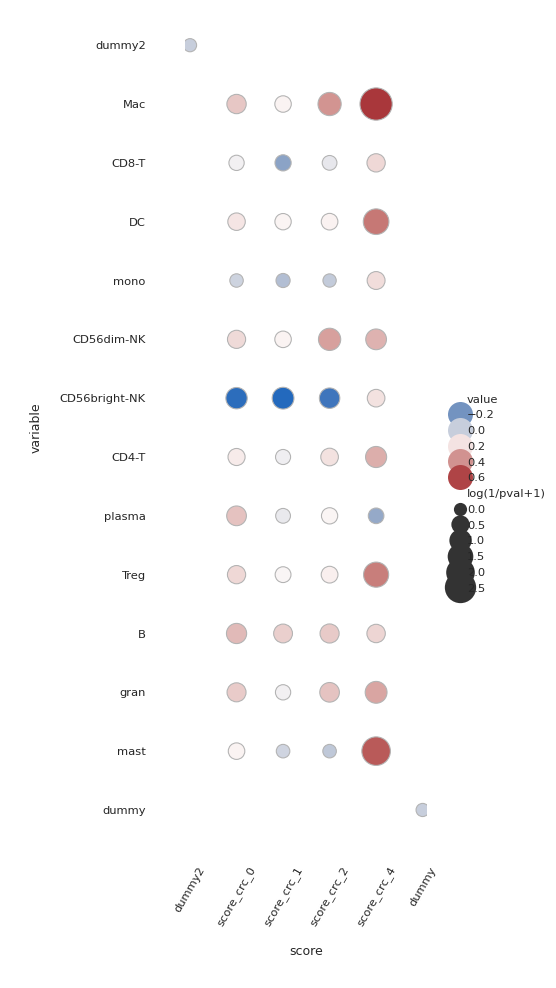

In [83]:
# Create a dotplot with mean of pos frac as dot hue and pos frac as dot size
sns.set(font_scale=0.25)
sns.set_style('white')
g = sns.relplot(
    data=corr_df_melt_merged,
    x="score", y="variable", hue="value", size='log(1/pval+1)',
    palette="vlag", edgecolor=".7",#hue_norm = (0,1),
    height=3, aspect=.5,sizes=(10, 60),
)
g.despine(left=True, bottom=True)
g.ax.margins(.02)
for label in g.ax.get_xticklabels():
    label.set_rotation(60)
for artist in g.legend.legendHandles:
    artist.set_edgecolor(".7")

fig_save_path_spec = fig_save_path+'Particle_dotplot_immune_corr.svg'
plt.savefig(fig_save_path_spec,dpi=300)

In [86]:
corr_df_melt_merged.to_csv(DATA_DIR+'source_data/Figure_1F.csv')

## Receptor ligand interaction

In [98]:
interaction_dict_path = '/mnt/d/Jupyter_lilac_250608_part/2023_Particle_SASP/2023_Particle_SASP/'+'notebooks/Ligand_Receptor_Pairs_TW_220804.csv'
ligand_modules = [['CCL19', 'CCL21', 'CCL4', 'CCL5', 'CXCL10', 'CXCL12', 'CXCL13', 'CXCL9'], ['CXCL2', 'CXCL3'], ['CCL13', 'CCL18', 'CCL3', 'CCL7'], ['CCL14', 'CCL15', 'CCL16', 'CCL17', 'CCL23', 'CCL24', 'CCL25', 'CCL26', 'CCL8'], ['CCL11', 'CCL2', 'CCL20', 'CCL22', 'CCL27', 'CCL28', 'CX3CL1', 'CXCL1', 'CXCL11', 'CXCL16', 'CXCL5', 'CXCL6', 'CXCL8']]

#adata_path = '/data/peer/wallet/Jupyter/PAAD-X-Peng_Sun-X-2019-X-10.1038s41422-019-0195-y-X-Jupyter/output_data/2021_PDAC_RT_Huber_Walle_raw_data_annotated_emptydrops_noribo_nomito_clustered_nodrops_doublets_nodoubs_libsize_log1p_clustered_10000hv_genes_curated_marker_genes_210216_reanalysis_forcytopus.h5ad'
#adata_path = '/data/peer/wallet/Jupyter/2023_Particle_SASP/data/PBMC-X-BTC-X-CITEseq-X-2022-X-Keenan-X-10.1016_j.celrep.2022.111384.h5ad'

adata = sc.read(adata_path)
adata

set(adata.obs['sample'])

adata = adata[~adata.obs['best_annotation'].isna()]
adata

adata = adata[adata.obs['best_annotation']!='Blood']
adata

adata = adata[adata.obs['best_annotation']!='T']
adata

#impute data
adata_indf = magic(adata, copy=True, verbose=True, solver='exact', n_pca=adata.obsm['X_pca'].shape[1], knn=5, t=3)
adata.layers['imputed'] = adata_indf.X

adata.write(adata_path)

set(adata.obs['best_annotation'])

mapping_dict = {'AS-DC':'DC',
 'B-memory-switched':'B',
 'B-naive':'B',
 'CD4-T':'CD4-T',
 'CD4-T-naive':'CD4-T',
 'CD4-TCM':'CD4-T',
 'CD56bright-NK':'CD56bright-NK',
 'CD56dim-NK':'CD56dim-NK',
 'CD8-T-KLRG1pos-effector':'CD8-T',
 'DC':'DC',
 'DN-B':'B',
 'MAIT':'MAIT',
 'NK':'NK',
 'NKT':'NKT',
 'Treg':'Treg',
 'c-mono':'mono',
 'cDC':'DC',
 'mo-DC':'DC',
 'nc-mono':'mono',
 'p-DC':'DC',
 'plasma-blast':'plasma'}

adata.obs['annotation_merged'] = adata.obs['best_annotation'].map(mapping_dict)
set(adata.obs['annotation_merged'])

adata = adata[adata.obs['primary_tumor']]
adata

set(adata.obs['annotations_cytopus_final'])

adata = adata[~adata.obs['annotations_cytopus_final'].isin(['B-T_doublet','T','Gr-MDC','T_proliferating',
                                                          'endothelial cell','epithelial cell', 'fibroblast and myocytes',
                                                           'neuroendocrine'])]
adata = adata[~adata.obs['annotations_cytopus_final'].isna()]

mapping_dict = {
 'B-memory-non-switched':'B',
 'B-memory-switched':'B',
 'B-naive':'B',
 'CD4-T-naive':'CD4-T',
 'CD4-TCM':'CD4-T',
 'CD4-TRM-TH17':'CD4-T',
 'CD4-TRM_terminally_exhausted':'CD4-T',
 'CD56bright-NK':'CD56bright-NK',
 'CD56dim-NK':'CD56dim-NK',
 'CD8-T':'CD8-T',
 'CD8-T-KLRG1neg-effector_nonexhausted':'CD8-T',
 'CD8-T-KLRG1pos-effector_nonexhausted':'CD8-T',
 'CD8-T-KLRG1pos-effector_preexhausted':'CD8-T',
 'CD8-TRM_nonexhausted':'CD8-T',
 'CD8-TRM_terminally_exhausted':'CD8-T',
 'GC-B':'B',
 'GC-B_proliferating':'B',
 'ILC3-NCR2pos':'ILC3-NCR2pos',
 'Mac':'Mac',
 'PV-Mac':'Mac',
 'Treg':'Treg',
 'c-mono':'mono',
 'cDC1':'DC',
 'cDC2':'DC',
 'cDC3':'DC',
 'nc-mono':'mono',
 'p-DC':'DC'}

In [99]:
set(adata_pretreated.obs['annotation_merged'])

{'(myo)fibroblast',
 'B',
 'CD4-T',
 'CD56bright-NK',
 'CD56dim-NK',
 'CD8-T',
 'DC',
 'Mac',
 'NK',
 'Treg',
 'adipocyte',
 'crc-carcinoma-cell',
 'endo',
 'endocrine',
 'epithelial',
 'fibroblast',
 'gran',
 'mast',
 'mono',
 'neuroendocrine',
 'neuron',
 'plasma',
 'schwann'}

adata.obs['annotation_merged'] = adata.obs['annotations_cytopus_final'].map(mapping_dict)
set(adata.obs['annotation_merged'])

In [100]:
interaction_df = pd.read_csv(interaction_dict_path)
interaction_df

,Ligand,Ligand_ENSEMBL,Receptor,Receptor_ENSEMBL,species,SOURCE (Literature or DAC-curated),DOI
0,ADIPOQ,NaN,ADIPOR1,NaN,homo_sapiens,DAC-curated,NaN
1,ADIPOQ,NaN,ADIPOR2,NaN,homo_sapiens,DAC-curated,NaN
2,ADORA1,NaN,ADORA2A,NaN,homo_sapiens,Steele et al. Nature Cancer 2020 (SUP TABLE 5),NaN
3,APOB,NaN,LDLR,NaN,homo_sapiens,Steele et al. Nature Cancer 2020 (SUP TABLE 5),NaN
4,APOE,NaN,LDLR,NaN,homo_sapiens,Steele et al. Nature Cancer 2020 (SUP TABLE 5),NaN
...,...,...,...,...,...,...,...
1076,TNFSF8,MGP_LPJ_G0028287,TNFRSF8,ENSMUSG00000028602,NaN,wallet,NaN
1077,NaN,NaN,VSIR,ENSMUSG00000020101,NaN,wallet,NaN
1078,NaN,NaN,VSIR,ENSG00000107738,NaN,wallet,NaN
1079,XCL1,ENSMUSG00000026573,XCR1,ENSMUSG00000060509,NaN,wallet,NaN


In [101]:
interaction_df = interaction_df[interaction_df['species']=='homo_sapiens']
interaction_df = interaction_df.set_index('Ligand')
interaction_df

,Ligand_ENSEMBL,Receptor,Receptor_ENSEMBL,species,SOURCE (Literature or DAC-curated),DOI
Ligand,,,,,,
ADIPOQ,NaN,ADIPOR1,NaN,homo_sapiens,DAC-curated,NaN
ADIPOQ,NaN,ADIPOR2,NaN,homo_sapiens,DAC-curated,NaN
ADORA1,NaN,ADORA2A,NaN,homo_sapiens,Steele et al. Nature Cancer 2020 (SUP TABLE 5),NaN
APOB,NaN,LDLR,NaN,homo_sapiens,Steele et al. Nature Cancer 2020 (SUP TABLE 5),NaN
APOE,NaN,LDLR,NaN,homo_sapiens,Steele et al. Nature Cancer 2020 (SUP TABLE 5),NaN
...,...,...,...,...,...,...
IFNA2,ENSG00000188379,IFNAR2,ENSG00000159110,homo_sapiens,wallet,NaN
IFNA7,ENSG00000214042,IFNAR2,ENSG00000159110,homo_sapiens,wallet,NaN
IFNA8,ENSG00000120242,IFNAR2,ENSG00000159110,homo_sapiens,wallet,NaN


In [102]:
interaction_dict = {}
for i in set(interaction_df.index):
    interaction_df_sub = interaction_df.loc[i]
    if isinstance(interaction_df.loc[i]['Receptor'],pd.core.series.Series):
        interaction_dict[i] = list(interaction_df.loc[i]['Receptor'])
    else:
        interaction_dict[i] = [interaction_df.loc[i]['Receptor']]

In [103]:
receptors= []
for i in ligand_modules:
    for x in i:
        receptors = receptors+ interaction_dict[x]      

receptors = list(set(receptors))
receptors = [x for x in receptors if x in adata_pretreated.var_names]

In [104]:
set(adata_pretreated.obs['annotation_merged'])

{'(myo)fibroblast',
 'B',
 'CD4-T',
 'CD56bright-NK',
 'CD56dim-NK',
 'CD8-T',
 'DC',
 'Mac',
 'NK',
 'Treg',
 'adipocyte',
 'crc-carcinoma-cell',
 'endo',
 'endocrine',
 'epithelial',
 'fibroblast',
 'gran',
 'mast',
 'mono',
 'neuroendocrine',
 'neuron',
 'plasma',
 'schwann'}

In [105]:
len(set(adata_pretreated[adata_pretreated.obs['annotation_merged'].isin([
 'B',
 'CD4-T',
 'CD56bright-NK',
 'CD56dim-NK',
 'CD8-T',
 'DC',
 'Mac',
 'NK',
 'Treg',
 'gran',
 'mast',
 'mono',
 'plasma',])].obs['sampleid']))

22

adata_crc = adata[adata.obs['annotation_merged'].isin([
 'B',
 'CD4-T',
 'CD56bright-NK',
 'CD56dim-NK',
 'CD8-T',
 'DC',
 'ILC3-NCR2pos',
 'Mac',
 'Treg',
 'mono'])]


In [106]:
np.random.seed(0)
adata_subset = adata_pretreated[adata_pretreated.obs['annotation_merged'].isin([
 'B',
 'CD4-T',
 'CD56bright-NK',
 'CD56dim-NK',
 'CD8-T',
 'DC',
 'Mac',
 'NK',
 'Treg',
 'gran',
 'mast',
 'mono',
 'plasma',])]
#adata_subset = adata_subset[adata_subset.obs['pretreated']=='True']
plot_df_corr = pd.DataFrame(adata_subset[:,receptors].layers['imputed'],index=adata_subset.obs_names,
                                              columns=receptors)
#plot_df_corr =scipy.stats.zscore(plot_df_corr)
plot_df_corr =  corr_cov_matrix_cluster(plot_df_corr,markers=['all_markers'], metric='spearman',
                                        clustering_method = 'average', linkage_distance=1.5)
plot_df_corr

output list order: dataframe, hierarchical flat clusters, row linkage, column linkage


[           ACKR2      SDC2      CCR7      CCR5      CCR4      CCR6      SDC4  \
 ACKR2   1.000000 -0.024112 -0.019657  0.050685 -0.020120  0.031436 -0.046010   
 SDC2   -0.024112  1.000000 -0.360937 -0.175671 -0.271521 -0.377912  0.782147   
 CCR7   -0.019657 -0.360937  1.000000 -0.046549  0.153036  0.290010 -0.255480   
 CCR5    0.050685 -0.175671 -0.046549  1.000000  0.242672  0.221311 -0.099709   
 CCR4   -0.020120 -0.271521  0.153036  0.242672  1.000000  0.033779 -0.170429   
 CCR6    0.031436 -0.377912  0.290010  0.221311  0.033779  1.000000 -0.299226   
 SDC4   -0.046010  0.782147 -0.255480 -0.099709 -0.170429 -0.299226  1.000000   
 ACKR4   0.159254 -0.048134  0.223739  0.123859 -0.037052  0.343554 -0.055748   
 CCR3    0.224786 -0.098883  0.228449  0.010217 -0.065510  0.079610 -0.064399   
 ACKR1   0.001825 -0.085862  0.103675  0.053485 -0.003094  0.115003 -0.004990   
 CXCR5   0.007863 -0.243521  0.397595 -0.063736  0.003371  0.674705 -0.183536   
 CXCR1  -0.007413 -0.051160 

In [107]:
#cell level imputed
import scipy
%matplotlib inline
sns.set(font_scale=2)
clustergrid = sns.clustermap(plot_df_corr[0], cmap='vlag', col_cluster=True,row_cluster=True, figsize=(60,30), 
                             #row_linkage=plot_df_corr[1],col_linkage=plot_df_corr[2],
                             vmin=-1,vmax=1,center=0,
               z_score=None) 

In [109]:
plot_df_corr[0].to_csv(DATA_DIR+'/source_data/Figure_1C_receptors.csv')

In [94]:
#cell level imputed
save_name = '2022_Hwang_irradiated_chemokine_receptor_heatmap.svg'
row_colors = [color_map_clusters_nogrey[x] for x in plot_df_corr[1]]
col_colors = [color_map_clusters_nogrey[x] for x in plot_df_corr[1]]
sns.set(font_scale=2)
clustergrid = sns.clustermap(plot_df_corr[0], cmap='vlag',# col_cluster=True,row_cluster=True, 
                             figsize=(60,60), 
                             row_linkage=plot_df_corr[2],col_linkage=plot_df_corr[2],
                             row_colors = row_colors, col_colors=col_colors,
                             vmin=-.6,vmax=.6,center=0,
               z_score=None) 
plt.savefig(fig_save_path+save_name)
print('saved to:',save_name)

saved to: 2022_Hwang_irradiated_chemokine_receptor_heatmap.svg


In [110]:
iter_df = pd.DataFrame(0,columns=receptors,index=receptors)
adata_subset = adata_subset = adata_pretreated[adata_pretreated.obs['annotation_merged'].isin([
 'B',
 'CD4-T',
 'CD56bright-NK',
 'CD56dim-NK',
 'CD8-T',
 'DC',
 'Mac',
 'NK',
 'Treg',
 'gran',
 'mast',
 'mono',
 'plasma',])]
iter_list = set(adata_subset.obs['sampleid'])
for i in iter_list:
    adata_subset_leaveoneout = adata_subset[adata_subset.obs['sampleid']!=i]
    plot_df_corr_leaveoneout = pd.DataFrame(adata_subset_leaveoneout[:,receptors].layers['imputed'],index=adata_subset_leaveoneout.obs_names,
                                              columns=receptors)
    #plot_df_corr =scipy.stats.zscore(plot_df_corr)
    plot_df_corr_leaveoneout =  corr_cov_matrix_cluster(plot_df_corr_leaveoneout,markers=['all_markers'], metric='spearman',
                                            clustering_method = 'average', linkage_distance=1.5)
    
    cluster_labels_leaveoneout =plot_df_corr_leaveoneout[1]
    variable_names_leaveoneout =plot_df_corr_leaveoneout[0].index
    # Get the indices of samples in each cluster
    clusters_leaveoneout = np.unique(cluster_labels_leaveoneout)
    cluster_indices_leaveoneout = [np.where(cluster_labels_leaveoneout == c)[0] for c in clusters_leaveoneout]
    
    # Get the variable names for each cluster
    cluster_variable_names_crc_leaveoneout = [[variable_names_leaveoneout[i] for i in ci] for ci in cluster_indices_leaveoneout]
    for j in cluster_variable_names_crc_leaveoneout:
        for g in receptors:
            for h in receptors:
                if g in j and h in j:
                    iter_df.loc[g,h] +=1
    print('finished patient',i)

output list order: dataframe, hierarchical flat clusters, row linkage, column linkage
finished patient MGH2101
output list order: dataframe, hierarchical flat clusters, row linkage, column linkage
finished patient MGHR11
output list order: dataframe, hierarchical flat clusters, row linkage, column linkage
finished patient 2540
output list order: dataframe, hierarchical flat clusters, row linkage, column linkage
finished patient 2462
output list order: dataframe, hierarchical flat clusters, row linkage, column linkage
finished patient MGHR2
output list order: dataframe, hierarchical flat clusters, row linkage, column linkage
finished patient MGHR7
output list order: dataframe, hierarchical flat clusters, row linkage, column linkage
finished patient 2634
output list order: dataframe, hierarchical flat clusters, row linkage, column linkage
finished patient 2229
output list order: dataframe, hierarchical flat clusters, row linkage, column linkage
finished patient MGH2381
output list order:

In [111]:
#correlation imputed cell level
save_name = '2022_Hwang_irradiated_cancercell_receptor_correlation_clustering_stability.svg'
cluster_color_dict = dict(zip(list(plot_df_corr[0].index), list(plot_df_corr[1])))
row_order = [plot_df_corr[0].index[x] for x in clustergrid.dendrogram_row.reordered_ind] 
col_order = [plot_df_corr[0].columns[x] for x in clustergrid.dendrogram_col.reordered_ind] 
row_colors = [cluster_color_dict[x] for x in row_order]
row_colors = [color_map_clusters_nogrey[x] for x in row_colors]
col_colors = [cluster_color_dict[x] for x in col_order]
col_colors = [color_map_clusters_nogrey[x] for x in col_colors]
df_iter_plot = iter_df/len(iter_list)
df_iter_plot = df_iter_plot.loc[row_order, col_order]
sns.set(font_scale=2)
clustergrid_2 = sns.clustermap(df_iter_plot, cmap='viridis', col_cluster=False,row_cluster=False, 
                             figsize=(60,60), 
                             row_linkage=plot_df_corr[2],col_linkage=plot_df_corr[2],
                             row_colors = row_colors, col_colors=col_colors,
                             vmin=0,vmax=1,
               z_score=None) 
plt.savefig(fig_save_path+save_name)
print('saved to:',save_name)

saved to: 2022_Hwang_irradiated_cancercell_receptor_correlation_clustering_stability.svg


In [114]:
df_iter_plot.to_csv(DATA_DIR+'/source_data/Figure_S1C_receptors.csv')

In [115]:
cluster_labels =plot_df_corr[1]
variable_names =plot_df_corr[0].index
# Get the indices of samples in each cluster
clusters = np.unique(cluster_labels)
cluster_indices = [np.where(cluster_labels == c)[0] for c in clusters]

# Get the variable names for each cluster
cluster_variable_names = [[variable_names[i] for i in ci] for ci in cluster_indices]

print(cluster_variable_names)

[['SDC2', 'SDC4', 'CCR1', 'ACKR3', 'ITGB1', 'CCRL2'], ['CXCR1', 'CXCR2'], ['CCR2', 'CX3CR1'], ['ACKR2', 'CCR7', 'CCR3', 'ACKR1', 'CCR10', 'CXCR3', 'HRH4', 'CD4', 'SDC1'], ['CCR6', 'ACKR4', 'CXCR5'], ['CCR4', 'CCR8'], ['CCR5', 'CCR9', 'CXCR6', 'CXCR4']]


receptor_modules = [['SDC4', 'ITGB1', 'ACKR3', 'CCRL2', 'SDC2', 'CCR1'], ['CXCR2', 'CXCR1'], ['CXCR6', 'CCR6', 'CCR5', 'CCR9', 'CXCR4']]

receptor_modules = [['CXCR5', 'CCR7'], ['CCR9', 'CXCR1', 'CCR5', 'CCR8', 'CCR3', 'CCR4', 'CXCR4', 'CXCR3', 'CXCR6', 'CCR6'], ['HRH4', 'ACKR2'], ['ACKR1'], ['CD4', 'CCRL2', 'GPR75', 'CX3CR1', 'CCR2', 'ACKR3', 'SDC2', 'CCR1'], ['CCR10'], ['CXCR2'], ['ITGB1', 'SDC1', 'SDC4'], ['ACKR4']]

In [116]:
receptor_modules = [['CCR1', 'CCRL2', 'ITGB1', 'ACKR3', 'SDC4', 'SDC2'], ['CXCR1', 'CXCR2'], ['CX3CR1', 'CCR2'], ['ACKR1', 'CD4', 'CCR10', 'CXCR3', 'CCR3', 'CCR7', 'HRH4', 'ACKR2', 'SDC1'], ['CCR6', 'ACKR4', 'CXCR5'], ['CCR4', 'CCR8'], ['CXCR6', 'CCR5', 'CCR9', 'CXCR4']]

In [117]:
#correlation per module

# get the lower diagonal of the correlation matrix
lower_diag = np.tril(plot_df_corr[0])
np.fill_diagonal(lower_diag, 0)
lower_diag[lower_diag == 0] = np.nan
lower_diagonal_df = pd.DataFrame(lower_diag, index=plot_df_corr[0].index, columns=plot_df_corr[0].columns)

for i,v in enumerate(receptor_modules):
    melted_df = pd.melt(lower_diagonal_df.loc[v,v])
    melted_df = melted_df[~melted_df['value'].isna()]
    print('mean for module',i,'is:',np.mean(melted_df['value']))

mean for module 0 is: 0.5238172774671758
mean for module 1 is: 0.7565149055152804
mean for module 2 is: 0.19631676816576868
mean for module 3 is: 0.17375961731283443
mean for module 4 is: 0.4482002482946141
mean for module 5 is: 0.23590740232722962
mean for module 6 is: 0.3736802562984982


In [118]:
connection_df = pd.DataFrame()
for i,module in enumerate(ligand_modules):
    for j,receptor_module in enumerate(receptor_modules):
        connections_sum = 0
        for ligand in module:
            interaction_partners = interaction_dict[ligand]
            connections = [x for x in interaction_partners if x in receptor_module]
            connections_sum += len(connections)
        connection_df.loc['ligand_mod_'+str(i),'receptor_mod_'+str(j)] = connections_sum

In [119]:
ligand_modules

[['CCL19', 'CCL21', 'CCL4', 'CCL5', 'CXCL10', 'CXCL12', 'CXCL13', 'CXCL9'],
 ['CXCL2', 'CXCL3'],
 ['CCL13', 'CCL18', 'CCL3', 'CCL7'],
 ['CCL14',
  'CCL15',
  'CCL16',
  'CCL17',
  'CCL23',
  'CCL24',
  'CCL25',
  'CCL26',
  'CCL8'],
 ['CCL11',
  'CCL2',
  'CCL20',
  'CCL22',
  'CCL27',
  'CCL28',
  'CX3CL1',
  'CXCL1',
  'CXCL11',
  'CXCL16',
  'CXCL5',
  'CXCL6',
  'CXCL8']]

In [120]:
connection_df

,receptor_mod_0,receptor_mod_1,receptor_mod_2,receptor_mod_3,receptor_mod_4,receptor_mod_5,receptor_mod_6
ligand_mod_0,7.0,0.0,0.0,22.0,5.0,2.0,3.0
ligand_mod_1,0.0,6.0,0.0,0.0,0.0,0.0,0.0
ligand_mod_2,3.0,0.0,2.0,10.0,2.0,1.0,3.0
ligand_mod_3,6.0,0.0,4.0,13.0,2.0,3.0,4.0
ligand_mod_4,3.0,8.0,3.0,19.0,3.0,2.0,3.0


In [121]:
import random
import copy

iter_count=0
df_comp_list = []
iter_num = 10000

ligand_modules_random = copy.deepcopy(ligand_modules)
elements = set()
for l in ligand_modules_random:
    elements.update(l)
        
while iter_count <iter_num:

    connection_df_random = pd.DataFrame()

    #shuffle the ligand list of lists randomly

    for l in ligand_modules_random:
        l[:] = random.sample(elements, len(l))
    for i,module in enumerate(ligand_modules_random):
        for j,receptor_module in enumerate(receptor_modules):
            connections_sum = 0
            for ligand in module:
                interaction_partners = interaction_dict[ligand]
                connections = [x for x in interaction_partners if x in receptor_module]
                connections_sum += len(connections)
            connection_df_random.loc['ligand_mod_'+str(i),'receptor_mod_'+str(j)] = connections_sum

    #compare whether the real data has more connections than the random
    df_comp_list.append( connection_df_random>=connection_df)

    iter_count+=1

/tmp/ipykernel_265/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/tmp/ipykernel_265/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/tmp/ipykernel_265/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/tmp/ipykernel_265/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/tmp/ipykernel_265/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/tmp/ipykernel_265/3687542856.py:20: Deprecat

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
since Python 3.9 and will be removed in a subsequent version.
  l[:] = random.sample(elements, len(l))
/scratch/lsftmp/18833952.tmpdir/ipykernel_58602/3687542856.py:20: DeprecationWarning: Sampling from a set deprecated
sin

In [122]:
merged_df = df_comp_list[0].astype(int)
for i in df_comp_list[1:]:
    merged_df = merged_df+ i.astype(int)

In [123]:
p_df = merged_df/iter_num
p_df

,receptor_mod_0,receptor_mod_1,receptor_mod_2,receptor_mod_3,receptor_mod_4,receptor_mod_5,receptor_mod_6
ligand_mod_0,0.0705,1.0000,1.0000,0.0241,0.0926,0.5463,0.6263
ligand_mod_1,1.0000,0.0022,1.0000,1.0000,1.0000,1.0000,1.0000
ligand_mod_2,0.3492,1.0000,0.2487,0.1863,0.3911,0.5992,0.1179
ligand_mod_3,0.3120,1.0000,0.1310,0.8224,0.8655,0.3244,0.4022
ligand_mod_4,0.9960,0.1546,0.7177,0.8620,0.8838,0.8356,0.9471


In [124]:
adata

AnnData object with n_obs × n_vars = 97987 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCAF

In [125]:
#stroke sizes for p values in illustrator
import math

def transform(x):
    a = math.log(1/(x),10)
    return a/2

p_df.applymap(lambda x:transform(x))

/tmp/ipykernel_265/2525544274.py:8: FutureWarning: DataFrame.applymap has been deprecated. Use DataFrame.map instead.
  p_df.applymap(lambda x:transform(x))


,receptor_mod_0,receptor_mod_1,receptor_mod_2,receptor_mod_3,receptor_mod_4,receptor_mod_5,receptor_mod_6
ligand_mod_0,0.575905,0.000000,0.000000,0.808991,0.516695,0.131284,0.101609
ligand_mod_1,0.000000,1.328789,0.000000,0.000000,0.000000,0.000000,0.000000
ligand_mod_2,0.228463,0.000000,0.302162,0.364894,0.203856,0.111214,0.464243
ligand_mod_3,0.252923,0.000000,0.441364,0.042458,0.031366,0.244460,0.197779
ligand_mod_4,0.000870,0.405395,0.072029,0.032246,0.026823,0.039001,0.011802


In [126]:
from statsmodels.stats.multitest import fdrcorrection

# correct p-values using Benjamini-Hochberg method
df_corrected = pd.DataFrame(fdrcorrection(p_df.values.flatten())[1].reshape(p_df.shape),
                            columns=p_df.columns,
                            index=p_df.index)
df_corrected

,receptor_mod_0,receptor_mod_1,receptor_mod_2,receptor_mod_3,receptor_mod_4,receptor_mod_5,receptor_mod_6
ligand_mod_0,0.764167,1.000,1.000000,0.421750,0.764167,1.0,1.000000
ligand_mod_1,1.000000,0.077,1.000000,1.000000,1.000000,1.0,1.000000
ligand_mod_2,1.000000,1.000,0.967167,0.815063,1.000000,1.0,0.764167
ligand_mod_3,1.000000,1.000,0.764167,1.000000,1.000000,1.0,1.000000
ligand_mod_4,1.000000,0.773,1.000000,1.000000,1.000000,1.0,1.000000


In [127]:
set(adata_subset.obs['annotation_merged'])

{'B',
 'CD4-T',
 'CD56bright-NK',
 'CD56dim-NK',
 'CD8-T',
 'DC',
 'Mac',
 'NK',
 'Treg',
 'gran',
 'mast',
 'mono',
 'plasma'}

In [128]:
set(adata_subset.obs['annotation_merged'])

{'B',
 'CD4-T',
 'CD56bright-NK',
 'CD56dim-NK',
 'CD8-T',
 'DC',
 'Mac',
 'NK',
 'Treg',
 'gran',
 'mast',
 'mono',
 'plasma'}

In [129]:
receptor_name_ls = []
for i,v in enumerate(receptor_modules):
    receptor_name = 'receptor_mod_'+str(i)
    adata_subset.obs[receptor_name] = list(np.mean(adata_subset[:,v].layers['zscored'],axis=1))
    receptor_name_ls.append(receptor_name)

/tmp/ipykernel_265/366065083.py:4: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata_subset.obs[receptor_name] = list(np.mean(adata_subset[:,v].layers['zscored'],axis=1))


In [130]:
receptor_name_ls = []
for i,v in enumerate(receptor_modules):
    receptor_name = 'receptor_mod_scoregenes_'+str(i)
    sc.tl.score_genes(adata_subset, v, ctrl_size=50, gene_pool=None, n_bins=25, 
                                                            score_name=receptor_name, random_state=0, copy=False, use_raw=None)
    receptor_name_ls.append(receptor_name)

computing score 'receptor_mod_scoregenes_0'
    finished: added
    'receptor_mod_scoregenes_0', score of gene set (adata.obs).
    250 total control genes are used. (0:00:00)
computing score 'receptor_mod_scoregenes_1'
    finished: added
    'receptor_mod_scoregenes_1', score of gene set (adata.obs).
    100 total control genes are used. (0:00:00)
computing score 'receptor_mod_scoregenes_2'
    finished: added
    'receptor_mod_scoregenes_2', score of gene set (adata.obs).
    100 total control genes are used. (0:00:00)
computing score 'receptor_mod_scoregenes_3'
    finished: added
    'receptor_mod_scoregenes_3', score of gene set (adata.obs).
    350 total control genes are used. (0:00:00)
computing score 'receptor_mod_scoregenes_4'
    finished: added
    'receptor_mod_scoregenes_4', score of gene set (adata.obs).
    150 total control genes are used. (0:00:00)
computing score 'receptor_mod_scoregenes_5'
    finished: added
    'receptor_mod_scoregenes_5', score of gene set (adat

In [131]:
receptor_name_ls_imputed = []
for i,v in enumerate(receptor_modules):
    receptor_name = 'receptor_mod_imputed_'+str(i)
    adata_subset.obs[receptor_name] = list(np.mean(np.array(adata_subset[:,v].X.todense()),axis=1))
    receptor_name_ls_imputed.append(receptor_name)

In [132]:
receptor_name_ls_scoregenes = ['receptor_mod_scoregenes_0',
 'receptor_mod_scoregenes_1',
 'receptor_mod_scoregenes_2',
 'receptor_mod_scoregenes_3',
 'receptor_mod_scoregenes_4',
 'receptor_mod_scoregenes_5',
 'receptor_mod_scoregenes_6']

    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_annotation_merged']`


/home/wallet/.local/lib/python3.10/site-packages/scanpy/tools/_dendrogram.py:192: ImplicitModificationWarning: Trying to modify attribute `._uns` of view, initializing view as actual.
  adata.uns[key_added] = dat


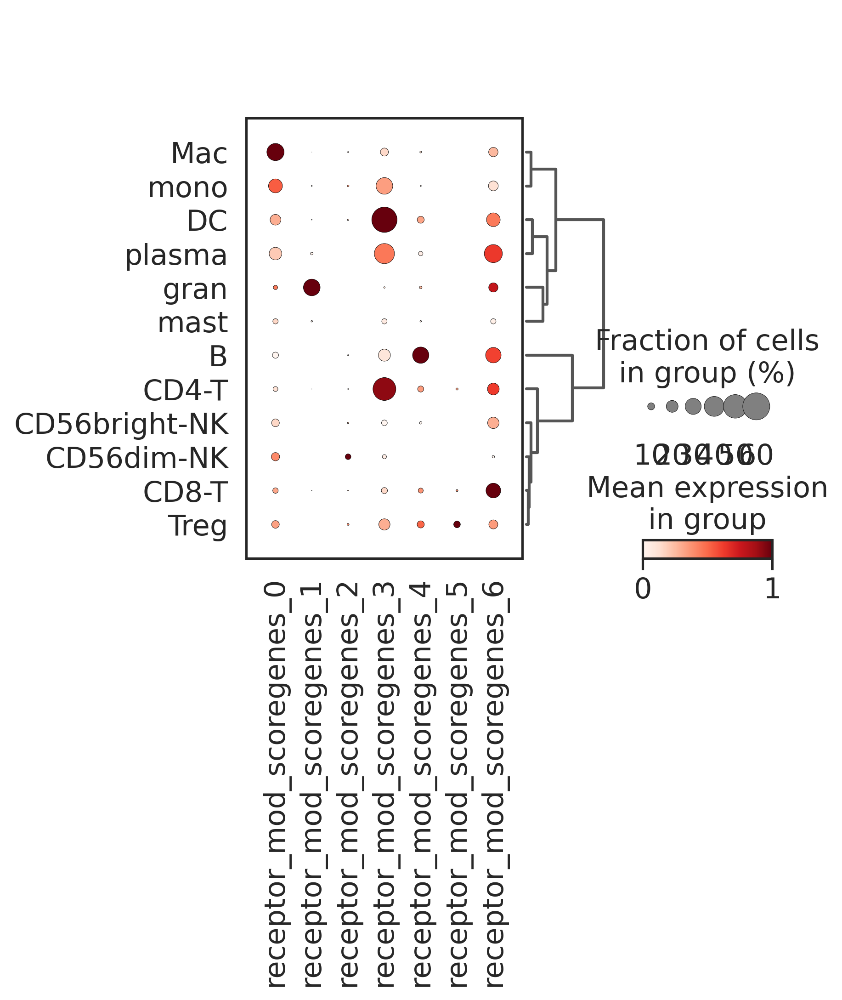

In [133]:
#dotplot
%matplotlib inline
sns.set(font_scale = 1.5)
sns.set_style('white')
adata_subset_plot = adata_subset[adata_subset.obs['annotation_merged']!='NK']
sc.tl.dendrogram(adata_subset_plot, groupby='annotation_merged')
sc.pl.dotplot(adata_subset_plot, receptor_name_ls_scoregenes, groupby='annotation_merged', dendrogram=True, standard_scale='var',
             save='Hwang_PDAC_chemokine-receptor_modules_dotplot.svg')

In [134]:
dp = sc.pl.dotplot(adata_subset_plot, receptor_name_ls_scoregenes, groupby='annotation_merged', standard_scale='var',show=False, return_fig=True, 
             )

# Two DataFrames are cached on the DotPlot object
pct_cells = dp.dot_size_df     # % of cells expressing each gene (rows = groups)
mean_expr = dp.dot_color_df    # mean expression used for the colour scale

# Write them out, inspect, etc.
pct_cells.to_csv(DATA_DIR+'/source_data/Figure_1E_dotplot_fraction_expressing.csv')
mean_expr.to_csv(DATA_DIR+'/source_data/Figure_1E_dotplot_mean_expression.csv')
print(pct_cells.head())

               receptor_mod_scoregenes_0  receptor_mod_scoregenes_1  \
B                               0.083507                   0.000000   
CD4-T                           0.061111                   0.001587   
CD56bright-NK                   0.113924                   0.000000   
CD56dim-NK                      0.125000                   0.000000   
CD8-T                           0.071826                   0.001670   

               receptor_mod_scoregenes_2  receptor_mod_scoregenes_3  \
B                               0.008351                   0.204593   
CD4-T                           0.006349                   0.480952   
CD56bright-NK                   0.012658                   0.075949   
CD56dim-NK                      0.075000                   0.050000   
CD8-T                           0.007238                   0.083519   

               receptor_mod_scoregenes_4  receptor_mod_scoregenes_5  \
B                               0.306889                   0.000000   
CD4-

In [189]:
pheno_heat = 'annotation_merged'

plot_df = adata_subset.obs[receptor_name_ls+[pheno_heat]].groupby('annotation_merged').mean()
plot_df

,receptor_mod_0,receptor_mod_1,receptor_mod_2,receptor_mod_3,receptor_mod_4,receptor_mod_5,receptor_mod_6
annotation_merged,,,,,,,
B,-0.179166,-0.017888,0.095969,0.162903,1.450151,-0.019756,0.385183
CD4-T,-0.204410,0.021226,0.116889,0.595814,0.332633,0.368040,0.357173
CD56bright-NK,-0.170395,-0.017888,0.117430,0.097233,-0.003409,-0.019756,0.282646
CD56dim-NK,-0.162610,-0.017888,1.418563,-0.014767,-0.071227,-0.019756,-0.011133
CD8-T,-0.178831,0.009935,0.134508,0.048598,0.289988,0.391579,0.898308
DC,-0.127296,0.102757,0.137617,0.888651,0.344051,-0.019756,0.366866
Mac,0.102107,-0.002640,0.125623,0.046612,0.005297,-0.019756,0.210907
NK,0.007923,-0.017888,-0.024530,0.770892,-0.071227,-0.019756,1.778689
Treg,-0.180468,-0.017888,0.364272,0.115835,0.475433,2.183181,0.506710


In [190]:
plot_df = plot_df.drop(index=['NK'])
plot_df

,receptor_mod_0,receptor_mod_1,receptor_mod_2,receptor_mod_3,receptor_mod_4,receptor_mod_5,receptor_mod_6
annotation_merged,,,,,,,
B,-0.179166,-0.017888,0.095969,0.162903,1.450151,-0.019756,0.385183
CD4-T,-0.204410,0.021226,0.116889,0.595814,0.332633,0.368040,0.357173
CD56bright-NK,-0.170395,-0.017888,0.117430,0.097233,-0.003409,-0.019756,0.282646
CD56dim-NK,-0.162610,-0.017888,1.418563,-0.014767,-0.071227,-0.019756,-0.011133
CD8-T,-0.178831,0.009935,0.134508,0.048598,0.289988,0.391579,0.898308
DC,-0.127296,0.102757,0.137617,0.888651,0.344051,-0.019756,0.366866
Mac,0.102107,-0.002640,0.125623,0.046612,0.005297,-0.019756,0.210907
Treg,-0.180468,-0.017888,0.364272,0.115835,0.475433,2.183181,0.506710
gran,-0.155447,10.438626,-0.024530,-0.029584,0.071684,-0.019756,0.297624


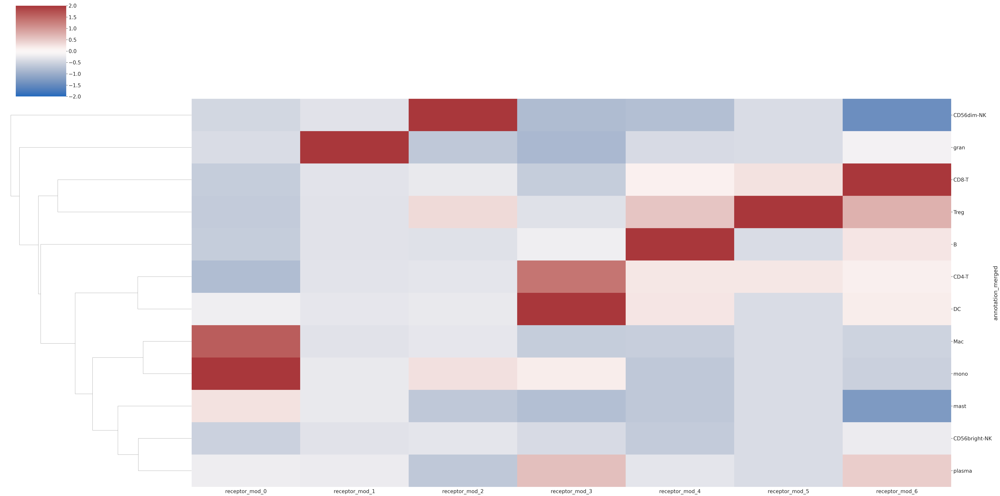

In [196]:
#SEACElls  imputed
import scipy
%matplotlib inline
save_name = 'Hwang_PDAC_pretreated_immune_receptor_module_expression_heatmap_zscored.svg'
sns.set(font_scale=2)
clustergrid = sns.clustermap(plot_df, cmap='vlag', col_cluster=False,row_cluster=True, figsize=(60,30), 
                             #row_linkage=plot_df_corr[1],col_linkage=plot_df_corr[2],
                             vmin=-2,vmax=2,center=0,

                             z_score=1) 

In [195]:
receptor_modules

[['SDC2', 'SDC4', 'ITGB1', 'ACKR3', 'CCRL2', 'CCR1'],
 ['CXCR1', 'CXCR2'],
 ['CCR2', 'CX3CR1'],
 ['HRH4', 'CXCR3', 'CD4', 'CCR3', 'CCR7', 'ACKR2', 'CCR10', 'ACKR1', 'SDC1'],
 ['ACKR4', 'CXCR5', 'CCR6'],
 ['CCR4', 'CCR8'],
 ['CXCR4', 'CCR9', 'CCR5', 'CXCR6']]

# Revision figures 

## quantify cytokine modules in non-irradiated vs irradiated

In [7]:
#adata_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo.h5ad'
adata_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_annotated.h5ad'
metadata_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-sample_metadata.csv'
adata_save_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_annotated_compressed.h5ad'
adata_save_path2 = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_annotated_compressed_dask4.h5ad'


In [ ]:
adata = sc.read(adata_path)
adata

In [ ]:
obsm_del = ['X_cnv', 'X_cnv_pca', 'X_cnv_umap', 'X_harmony',]

for i in obsm_del:
    del adata.obsm[i]

In [ ]:
obs_del = ['scrublet_scores', 'n_genes_by_counts',
           'log1p_n_genes_by_counts',  'log1p_total_counts', 'n_counts_sat',
           'n_genes_sat',  'leiden',  'Moffitt_basal', 'Moffitt_classical', 
           'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS',
           'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 
           'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 
           'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 
           'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated',
           'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 
           'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCAF', 'CAF', 'Tuveson_iCAF', 'Tuveson_mCAF', 'Neuzillet_CAFa', 
           'Neuzillet_CAFb', 'Neuzillet_CAFc', 'Neuzillet_CAFd', 'Davidson_CAF1', 'Davidson_CAF2', 'Davidson_CAF3', 'Pan_Stellate',
           'Quiescent_Stellate', 'Activated_Stellate', 'Immune_Stellate', 'FIBROBLASTS', 'PANCREATIC_SCHWANN_CELLS', 'ductal14', 'ductal2', 
           'ductal3', 'ductal4', 'DUCTAL', 'celltype_infercnv', 'cnv_leiden', 'cnv_score',
         ]

for i in obs_del:
    del adata.obs[i]

In [ ]:
adata

In [ ]:
var_del = ['chromosome', 'start', 'end', 'ensg', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection']

for i in var_del:
    del adata.var[i]

In [ ]:
uns_del = ['Level 1 Annotation_colors', 'Level 2 Annotation_colors', 
           'broad_celltypes_colors', 'cnv', 'cnv_leiden_colors', 'cnv_neighbors', 
           'hvg',  'new_celltypes_colors', 'pid_colors',]
for i in uns_del:
    del adata.uns[i]

In [ ]:
obsp_del= ['cnv_neighbors_connectivities', 'cnv_neighbors_distances', ]

for i in obsp_del:
    del adata.obsp[i]

In [23]:
del adata.layers['imputed']

In [19]:
adata.write(adata_save_path)

In [38]:
adata = sc.read(adata_save_path)
adata

AnnData object with n_obs × n_vars = 207661 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'pid', 'total_counts', 'percent_mito', 'batch', 'broad_celltypes', 'treatment_status', 'celltypes', 'new_celltypes', 'Level 1 Annotation', 'Level 2 Annotation', 'Level 3 Annotation', 'new_treatment', 'response', 'pretreated', 'pretreatment_CTX', 'SEACell', 'annotation', 'pheno_annotate'
    uns: 'leiden', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [39]:
metadata_df = pd.read_csv(metadata_path,index_col='patient_ID')
metadata_df

,tissue_type,tissue,pretreated,pretreatment,pretreatment_ICT,pretreatment_CTX,sequencing_technique
patient_ID,,,,,,,
U1,primary,pancreas,False,NaN,False,False,10x_v3
U2,primary,pancreas,False,NaN,False,False,10x_v3
U3,primary,pancreas,False,NaN,False,False,10x_v3
U4,primary,pancreas,False,NaN,False,False,10x_v2
U5,primary,pancreas,False,NaN,False,False,10x_v3
U6,primary,pancreas,False,NaN,False,False,10x_v3
U7,primary,pancreas,False,NaN,False,False,10x_v3
U8,primary,pancreas,False,NaN,False,False,10x_v3
U9,primary,pancreas,False,NaN,False,False,10x_v3


In [40]:
set(adata.obs['annotation'])

{'B',
 'B-T_doublet',
 'B-memory-DN',
 'B-naive',
 'B_proliferating',
 'CD4-T-naive',
 'CD4-TSCM_TFH',
 'CD56bright-NK',
 'CD56dim-NK',
 'CD8-T',
 'CD8-TRM',
 'CD8-T_KLRG1pos-effector',
 'GC-B',
 'Mac',
 'NK',
 'PV-Mac',
 'T',
 'T_proliferating',
 'Treg',
 'all_ADM',
 'all_Acinar',
 'all_Acinar (REG+)',
 'all_Adipocyte',
 'all_Alpha',
 'all_Beta',
 'all_CAF',
 'all_Delta',
 'all_Ductal',
 'all_Ductal (atypical)',
 'all_Epsilon',
 'all_Gamma',
 'all_Hormone-negative neuroendocrine',
 'all_Intra-pancreatic neurons',
 'all_Lymphatic',
 'all_Malignant',
 'all_Pericyte',
 'all_Schwann',
 'all_Vascular',
 'all_Vascular smooth muscle',
 'all_myCAF',
 'c-mono',
 'cDC1',
 'cDC2',
 'cDC3',
 'gran',
 'mast',
 'nc-mono',
 'p-DC',
 'plasma'}

In [41]:
adata = adata[~adata.obs['annotation'].isin(['B-T_doublet'])]
adata

View of AnnData object with n_obs × n_vars = 207195 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'pid', 'total_counts', 'percent_mito', 'batch', 'broad_celltypes', 'treatment_status', 'celltypes', 'new_celltypes', 'Level 1 Annotation', 'Level 2 Annotation', 'Level 3 Annotation', 'new_treatment', 'response', 'pretreated', 'pretreatment_CTX', 'SEACell', 'annotation', 'pheno_annotate'
    uns: 'leiden', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [42]:
import cytopus as cp
G = cp.KnowledgeBase()
G.identities.keys()

ImportError: cannot import name 'tarfile' from 'backports' (/home/wallet/miniconda3/envs/2023_scanpy_base/lib/python3.10/site-packages/backports/__init__.py)

In [43]:
#less granular annotations

mapping_dict = {'B':'B',
 'B-memory-DN':'B',
 'B-naive':'B',
 'B_proliferating':'B',
 'CD4-T-naive':'CD4-T',
 'CD4-TSCM_TFH':'CD4-T',
 'CD56bright-NK':'CD56bright-NK',
 'CD56dim-NK':'CD56dim-NK',
 'CD8-T':'CD8-T',
 'CD8-TRM':'CD8-T',
 'CD8-T_KLRG1pos-effector':'CD8-T',
 'GC-B':'B',
 'Mac':'Mac',
 'NK':'NK',
 'PV-Mac':'Mac',
 'T':'T',
 'T_proliferating':'T',
 'Treg':'Treg',
 'all_ADM':'epithelial',
 'all_Acinar':'epithelial',
 'all_Acinar (REG+)':'epithelial',
 'all_Adipocyte':'adipocyte',
 'all_Alpha':'endocrine',
 'all_Beta':'endocrine',
 'all_CAF':'(myo)fibroblast',
 'all_Delta':'endocrine',
 'all_Ductal':'epithelial',
 'all_Ductal (atypical)': 'epithelial',
 'all_Epsilon':'endocrine',
 'all_Gamma':'endocrine',
 'all_Hormone-negative neuroendocrine':'neuroendocrine',
 'all_Intra-pancreatic neurons':'neuron',
 'all_Lymphatic':'endo',
 'all_Malignant':'crc-carcinoma-cell',
 'all_Pericyte':'fibroblast',
 'all_Schwann':'schwann',
 'all_Vascular':'endo',
 'all_Vascular smooth muscle':'(myo)fibroblast',
 'all_myCAF':'(myo)fibroblast',
 'c-mono':'mono',
 'cDC1':'DC',
 'cDC2':'DC',
 'cDC3':'DC',
 'gran':'gran',
 'mast':'mast',
 'nc-mono':'mono',
 'p-DC':'DC',
 'plasma':'plasma'}

In [44]:
adata.obs['annotation_merged']= adata.obs['annotation'].map(mapping_dict)
adata.obs['annotation_merged'].value_counts()

/tmp/ipykernel_366/667598449.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['annotation_merged']= adata.obs['annotation'].map(mapping_dict)


annotation_merged
crc-carcinoma-cell    63861
(myo)fibroblast       55622
epithelial            29388
endo                  16201
fibroblast            11474
Mac                    9648
endocrine              7139
CD8-T                  3405
CD4-T                  1831
schwann                1714
neuroendocrine         1599
T                      1246
B                      1241
Treg                    533
adipocyte               530
DC                      464
mono                    459
mast                    263
NK                      164
plasma                  112
CD56bright-NK           104
gran                     98
CD56dim-NK               74
neuron                   25
Name: count, dtype: int64

In [45]:
#remove uncompletely characterized cell types
adata = adata[~adata.obs['annotation_merged'].isin(['T'])]
adata

View of AnnData object with n_obs × n_vars = 205949 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'pid', 'total_counts', 'percent_mito', 'batch', 'broad_celltypes', 'treatment_status', 'celltypes', 'new_celltypes', 'Level 1 Annotation', 'Level 2 Annotation', 'Level 3 Annotation', 'new_treatment', 'response', 'pretreated', 'pretreatment_CTX', 'SEACell', 'annotation', 'pheno_annotate', 'annotation_merged'
    uns: 'leiden', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [46]:
from scipy.sparse import csr_matrix

adata = adata.copy()
adata.X = csr_matrix(adata.layers["counts"])

KeyboardInterrupt: 

In [ ]:
sc.pp.normalize_total(adata,target_sum=None, exclude_highly_expressed=False, 
                      max_fraction=0.05, key_added=None, 
                       inplace=True, copy=False)

sc.pp.log1p(adata, base=None, copy=False, chunked=None, chunk_size=None, 
            layer=None, obsm=None)

In [ ]:
adata.X

In [ ]:
adata

In [ ]:
adata.write(adata_save_path2)

In [47]:
adata = sc.read(adata_save_path2)

KeyboardInterrupt: 

In [ ]:
adata = adata[adata.obs['annotation_merged']=='crc-carcinoma-cell']
adata

In [117]:
n_obs, n_vars = adata.n_obs, adata.n_vars
gene_chunk_size = 500  

In [118]:
# Prepare arrays for means & stds
means = np.zeros(n_vars, dtype=np.float64)
stds  = np.zeros(n_vars, dtype=np.float64)

In [119]:
# 2) Compute means in gene-wise chunks
for g_start in range(0, n_vars, gene_chunk_size):
    g_end = min(g_start + gene_chunk_size, n_vars)
    sum_chunk = np.zeros(g_end - g_start, dtype=np.float64)

    # iterate row-blocks to accumulate sums
    for block_matrix, _, _ in adata.chunked_X(chunk_size=1000):
        # slice the block to current gene chunk
        sub = block_matrix[:, g_start:g_end]
        sub_arr = sub.toarray() if hasattr(sub, "toarray") else sub
        sum_chunk += sub_arr.sum(axis=0)

    means[g_start:g_end] = sum_chunk / n_obs

In [120]:
# 3) Compute stds (two-pass algorithm) in the same chunk loops
for g_start in range(0, n_vars, gene_chunk_size):
    g_end = min(g_start + gene_chunk_size, n_vars)
    sq_sum = np.zeros(g_end - g_start, dtype=np.float64)

    for block_matrix, _, _ in adata.chunked_X(chunk_size=1000):
        sub = block_matrix[:, g_start:g_end]
        sub_arr = sub.toarray() if hasattr(sub, "toarray") else sub
        # accumulate squared deviations
        sq_sum += ((sub_arr - means[g_start:g_end]) ** 2).sum(axis=0)

    stds[g_start:g_end] = np.sqrt(sq_sum / n_obs)


In [121]:
# 4) Build the z-scored sparse matrix in gene chunks
z_chunks = []
for g_start in range(0, n_vars, gene_chunk_size):
    g_end = min(g_start + gene_chunk_size, n_vars)
    # extract the full slice for this gene block
    block = adata.X[:, g_start:g_end].tocoo()  # COO for direct .data access
    # apply (x - mu) / sigma on the nonzero entries
    block.data = (block.data - means[g_start:g_end][block.col]) \
                 / stds[g_start:g_end][block.col]
    z_chunks.append(block.tocsr())

In [122]:
# 5) Horizontally stack all gene-chunk matrices
X_zscored = sparse.hstack(z_chunks, format="csr")



In [123]:
# 6) Store as a new layer (or replace .X if you like)
adata.layers["zscore"] = X_zscored


/tmp/ipykernel_335/1683336181.py:2: ImplicitModificationWarning: Setting element `.layers['zscore']` of view, initializing view as actual.
  adata.layers["zscore"] = X_zscored


In [20]:
np.mean(adata.layers["zscore"] ,axis=0)

matrix([[0.        , 0.00220353, 0.        , ..., 0.09498648, 0.        ,
         0.        ]])

In [24]:
adata.layers["zscore"]

<Compressed Sparse Row sparse matrix of dtype 'float64'
	with 275400933 stored elements and shape (205949, 22164)>

In [21]:
np.mean(adata.layers["zscore"] ,axis=0).shape

(1, 22164)

In [16]:
#adata.write(adata_save_path2)

In [48]:
adata = sc.read(adata_save_path2)
adata

AnnData object with n_obs × n_vars = 205949 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'pid', 'total_counts', 'percent_mito', 'batch', 'broad_celltypes', 'treatment_status', 'celltypes', 'new_celltypes', 'Level 1 Annotation', 'Level 2 Annotation', 'Level 3 Annotation', 'new_treatment', 'response', 'pretreated', 'pretreatment_CTX', 'SEACell', 'annotation', 'pheno_annotate', 'annotation_merged'
    uns: 'leiden', 'log1p', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'zscore'
    obsp: 'connectivities', 'distances'

In [10]:
ligand_modules = [['CCL19', 'CCL21', 'CCL4', 'CCL5', 'CXCL10', 'CXCL12', 'CXCL13', 'CXCL9'], ['CXCL2', 'CXCL3'], ['CCL13', 'CCL18', 'CCL3', 'CCL7'],  ['CCL11', 'CCL2', 'CCL20', 'CCL22', 'CCL27', 'CCL28', 'CX3CL1', 'CXCL1', 'CXCL11', 'CXCL16', 'CXCL5', 'CXCL6', 'CXCL8']]
module_names = ['module_1','module_2','module_3','module_4',]

In [133]:
for h,i in enumerate(ligand_modules):
    #adata.obs[module_names[h]] = np.asarray(np.mean(adata[:,i].layers['zscore'],axis=1).flatten()).flatten()
    sc.tl.score_genes(adata, i, ctrl_as_ref=True, 
                      ctrl_size=50, 
                      gene_pool=None, 
                      n_bins=25, 
                      score_name=module_names[h], 
                      random_state=0, copy=False, use_raw=None, layer=None)


computing score 'module_1'
    finished: added
    'module_1', score of gene set (adata.obs).
    200 total control genes are used. (0:00:02)
computing score 'module_2'
    finished: added
    'module_2', score of gene set (adata.obs).
    99 total control genes are used. (0:00:01)
computing score 'module_3'
    finished: added
    'module_3', score of gene set (adata.obs).
    150 total control genes are used. (0:00:01)
computing score 'module_4'
    finished: added
    'module_4', score of gene set (adata.obs).
    600 total control genes are used. (0:00:01)


In [134]:
np.sum(pd.crosstab(adata.obs['sampleid'],adata.obs['pid']) !=0)

/home/wallet/.local/lib/python3.10/site-packages/numpy/core/fromnumeric.py:86: FutureWarning: The behavior of DataFrame.sum with axis=None is deprecated, in a future version this will reduce over both axes and return a scalar. To retain the old behavior, pass axis=0 (or do not pass axis)
  return reduction(axis=axis, out=out, **passkwargs)


pid
T1     1
T2     1
T3     1
T4     1
T5     1
T6     1
T7     1
T8     1
T9     1
T10    1
T11    1
T12    1
T13    2
T14    1
T15    1
T16    1
T17    1
T18    1
T19    1
T20    1
T21    1
U1     1
U2     1
U3     1
U4     1
U5     1
U6     1
U7     1
U8     1
U9     1
U10    1
U11    1
U12    1
U13    1
U14    1
U15    1
U16    1
U17    1
U18    1
dtype: int64

In [135]:
set(adata.obs['annotation_merged'])

{'crc-carcinoma-cell'}

In [136]:
module_scores = []
for i in module_names:
    module_scores.append(adata_subset.obs[[i,'pid']].groupby('pid').mean())

/tmp/ipykernel_335/3230426763.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  module_scores.append(adata_subset.obs[[i,'pid']].groupby('pid').mean())
/tmp/ipykernel_335/3230426763.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  module_scores.append(adata_subset.obs[[i,'pid']].groupby('pid').mean())
/tmp/ipykernel_335/3230426763.py:3: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  module_scores.append(adata_subset.

In [137]:
module_score_df = pd.concat(module_scores,axis=1)
module_score_df

,module_1,module_2,module_3,module_4
pid,,,,
T1,-0.002859,-0.023114,-0.001667,-0.001794
T2,-0.011123,-0.050411,-0.001591,-0.009921
T3,-0.002781,0.083912,-0.001598,0.003461
T4,-0.004806,0.115419,-0.000743,0.007665
T5,-0.007596,-0.007356,-0.003418,0.001961
T6,-0.006310,-0.017590,-0.003399,-0.004069
T7,0.011515,0.032095,-0.006530,0.018157
T8,0.190044,-0.052235,-0.008841,-0.009137
T9,-0.002328,-0.036716,-0.003223,-0.005986


In [138]:
module_score_df['treatment'] = [x[0] for x in module_score_df.index]
module_score_df

,module_1,module_2,module_3,module_4,treatment
pid,,,,,
T1,-0.002859,-0.023114,-0.001667,-0.001794,T
T2,-0.011123,-0.050411,-0.001591,-0.009921,T
T3,-0.002781,0.083912,-0.001598,0.003461,T
T4,-0.004806,0.115419,-0.000743,0.007665,T
T5,-0.007596,-0.007356,-0.003418,0.001961,T
T6,-0.006310,-0.017590,-0.003399,-0.004069,T
T7,0.011515,0.032095,-0.006530,0.018157,T
T8,0.190044,-0.052235,-0.008841,-0.009137,T
T9,-0.002328,-0.036716,-0.003223,-0.005986,T


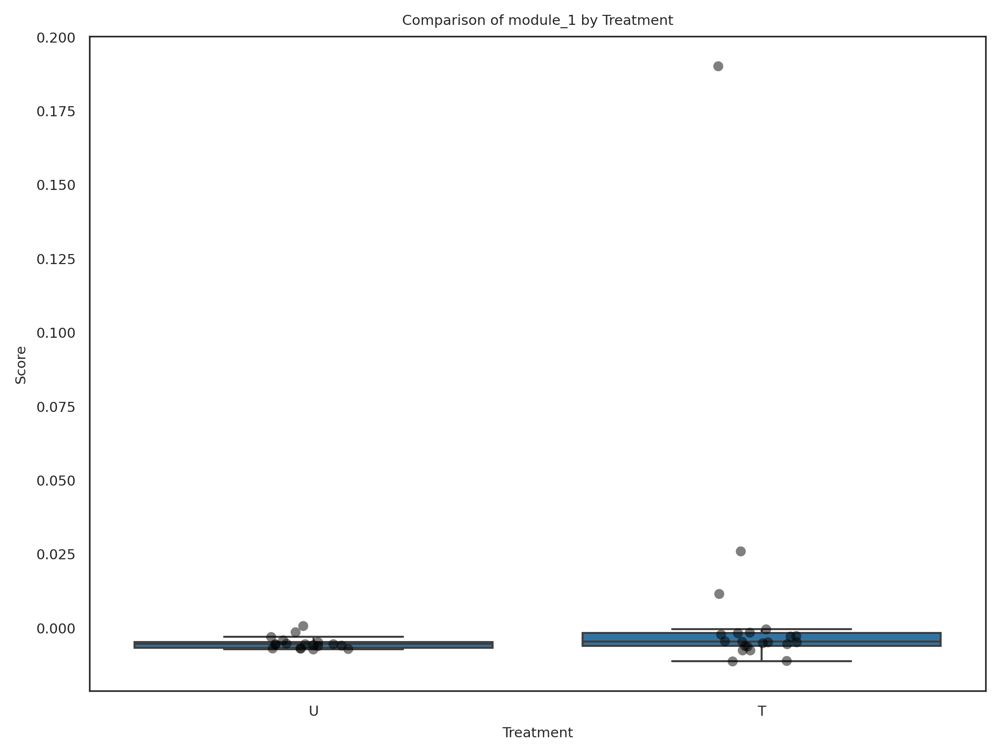

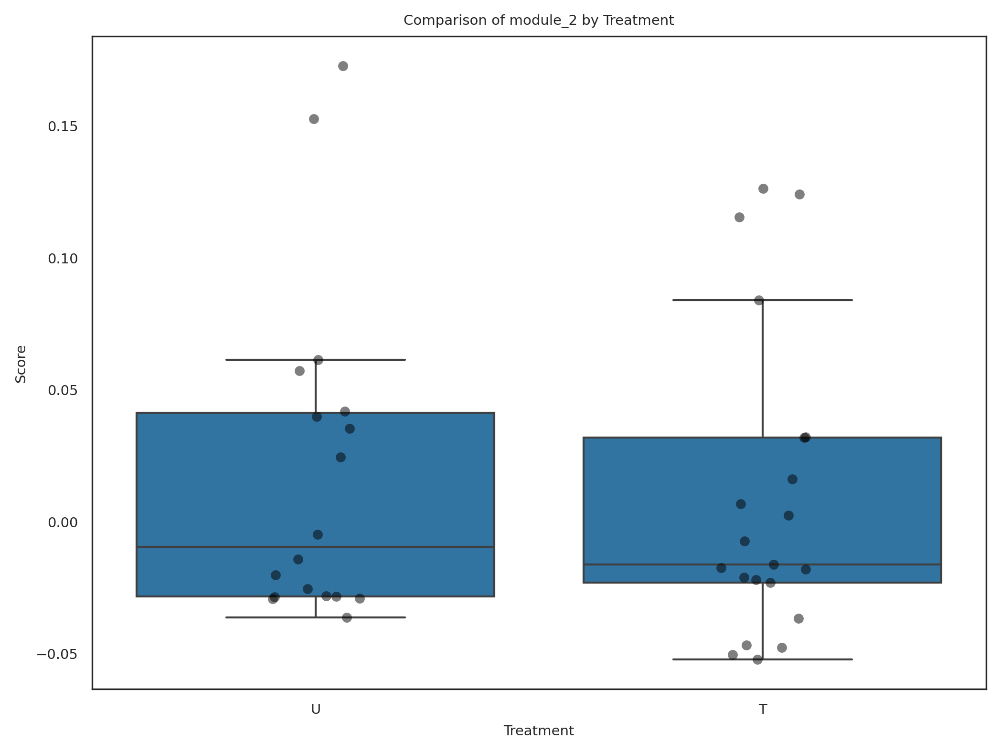

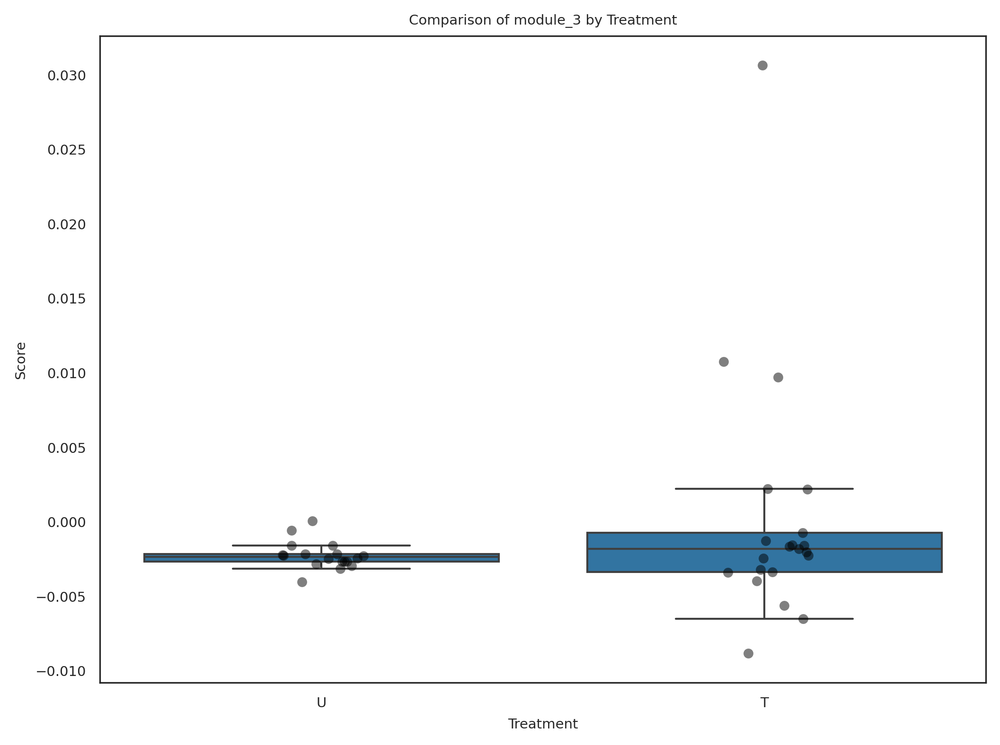

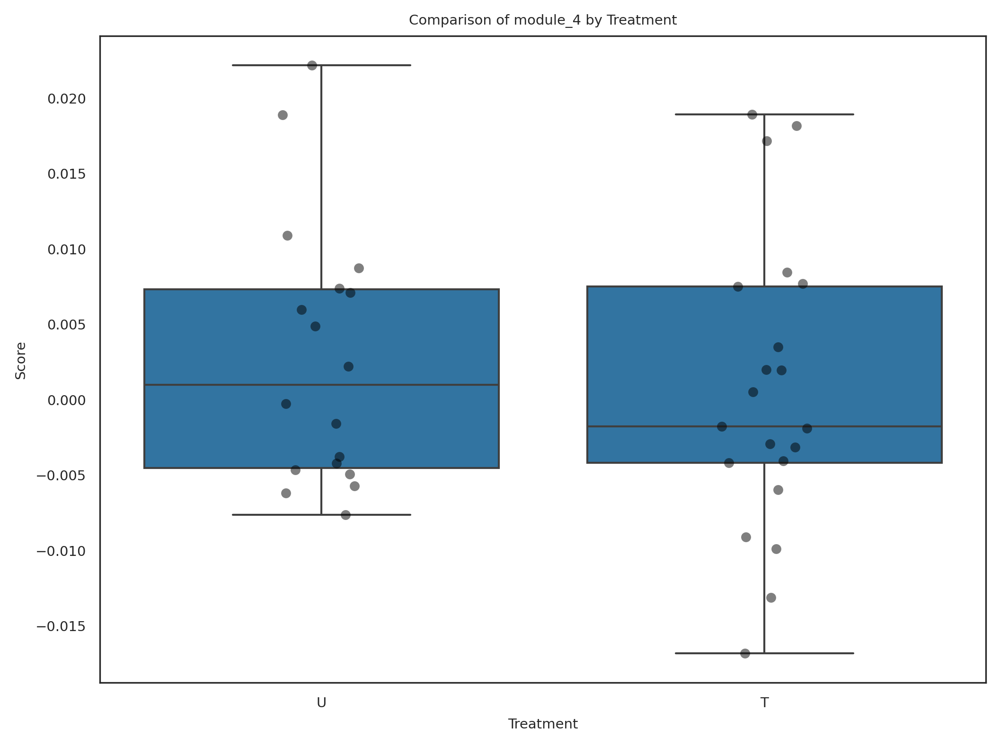

In [140]:
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming module_score_df is your DataFrame and it has columns for module scores and a 'treatment' column
# Loop through each column in the DataFrame
for column in module_score_df.columns:
    if column != 'treatment':  # Skip the treatment column
        plt.figure(figsize=(8, 6))
        sns.boxplot(data=module_score_df, x='treatment', y=column, order=['U', 'T'], showfliers=False)
        sns.stripplot(data=module_score_df, x='treatment', y=column, order=['U', 'T'], color='black', alpha=0.5, jitter=True)

        # Add labels and title
        plt.xlabel('Treatment')
        plt.ylabel('Score')
        plt.title(f'Comparison of {column} by Treatment')

        # Show the plot
        plt.show()



In [7]:
adata = sc.read(DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_annotated_RTX.h5ad'
)
adata

AnnData object with n_obs × n_vars = 97987 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'scrublet_scores', 'pid', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts_sat', 'n_genes_sat', 'percent_mito', 'leiden', 'batch', 'Moffitt_basal', 'Moffitt_classical', 'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS', 'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated', 'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCAF

In [8]:
obsm_del = ['X_cnv', 'X_cnv_pca', 'X_cnv_umap', 'X_harmony',]

for i in obsm_del:
    del adata.obsm[i]

In [9]:
obs_del = ['scrublet_scores', 'n_genes_by_counts',
           'log1p_n_genes_by_counts',  'log1p_total_counts', 'n_counts_sat',
           'n_genes_sat',  'leiden',  'Moffitt_basal', 'Moffitt_classical', 
           'Bailey_squamous', 'Bailey_progenitor', 'Collison_QM', 'Collison_classical', 'MALIGNANT CELLS',
           'ACINAR', 'Alpha', 'Beta', 'Delta', 'Gamma', 'Episilon', 'ENDOCRINE', 'ENDOTHELIAL', 'Pan_Immune', 
           'AntigenPresentingCells', 'Monocytes_1', 'Monocytes_2', 'Macrophage', 'cDC1', 'cDC2', 'DC_activated', 
           'pDC', 'Mast', 'Eosinophils', 'Neutrophils', 'M0', 'M1', 'M2', 'Mast_Resting', 'Mast_activated', 'CD8_Tcells', 
           'CD4_Tcells', 'NK', 'CD8_gammadelta', 'CD8_exhausted', 'CD4_naive', 'CD4_memory_resting', 'CD4_memory_activated',
           'CD4_follicular_helper', 'CD4_regulatory', 'NK_resting', 'NK_activated', 'B_cell', 'Plasma', 'Bcell_naive', 
           'Bcell_memory', 'IMMUNE', 'PanCAF', 'iCAF', 'myCAF', 'apCAF', 'CAF', 'Tuveson_iCAF', 'Tuveson_mCAF', 'Neuzillet_CAFa', 
           'Neuzillet_CAFb', 'Neuzillet_CAFc', 'Neuzillet_CAFd', 'Davidson_CAF1', 'Davidson_CAF2', 'Davidson_CAF3', 'Pan_Stellate',
           'Quiescent_Stellate', 'Activated_Stellate', 'Immune_Stellate', 'FIBROBLASTS', 'PANCREATIC_SCHWANN_CELLS', 'ductal14', 'ductal2', 
           'ductal3', 'ductal4', 'DUCTAL', 'celltype_infercnv', 'cnv_leiden', 'cnv_score',
         ]

for i in obs_del:
    del adata.obs[i]

In [10]:
adata

AnnData object with n_obs × n_vars = 97987 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'pid', 'total_counts', 'percent_mito', 'batch', 'broad_celltypes', 'treatment_status', 'celltypes', 'new_celltypes', 'Level 1 Annotation', 'Level 2 Annotation', 'Level 3 Annotation', 'new_treatment', 'response', 'pretreated', 'pretreatment_CTX', 'SEACell', 'annotation', 'pheno_annotate', 'annotation_merged', 'score_crc_0', 'score_crc_nonzscored_0', 'score_crc_1', 'score_crc_nonzscored_1', 'score_crc_2', 'score_crc_nonzscored_2', 'score_crc_3', 'score_crc_nonzscored_3', 'score_crc_4', 'score_crc_nonzscored_4'
    var: 'chromosome', 'start', 'end', 'ensg', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection'
    uns: 'Level 1 Annotation_colors', 'Level 2 Annotation_colors', 'broad_celltypes_colors', 'cnv', 'cnv_leiden_colors', 'cnv_neighbors', 'dendrogram_annotation_merged', 'hvg', 'leiden', 'neighbors', 'new_celltypes_colors'

In [11]:
var_del = ['chromosome', 'start', 'end', 'ensg', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'highly_variable_nbatches', 'highly_variable_intersection']

for i in var_del:
    del adata.var[i]

In [12]:
uns_del = ['Level 1 Annotation_colors', 'Level 2 Annotation_colors', 
           'broad_celltypes_colors', 'cnv', 'cnv_leiden_colors', 'cnv_neighbors', 
           'hvg',  'new_celltypes_colors', 'pid_colors',]
for i in uns_del:
    del adata.uns[i]

In [13]:
obsp_del= ['cnv_neighbors_connectivities', 'cnv_neighbors_distances', ]

for i in obsp_del:
    del adata.obsp[i]

In [14]:
del adata.layers['imputed']

In [19]:
adata.write(DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_annotated_RTX_compressed.h5ad')

In [8]:
adata = sc.read(DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_annotated_RTX_compressed.h5ad')
adata

AnnData object with n_obs × n_vars = 97987 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'pid', 'total_counts', 'percent_mito', 'batch', 'broad_celltypes', 'treatment_status', 'celltypes', 'new_celltypes', 'Level 1 Annotation', 'Level 2 Annotation', 'Level 3 Annotation', 'new_treatment', 'response', 'pretreated', 'pretreatment_CTX', 'SEACell', 'annotation', 'pheno_annotate', 'annotation_merged', 'score_crc_0', 'score_crc_nonzscored_0', 'score_crc_1', 'score_crc_nonzscored_1', 'score_crc_2', 'score_crc_nonzscored_2', 'score_crc_3', 'score_crc_nonzscored_3', 'score_crc_4', 'score_crc_nonzscored_4'
    uns: 'dendrogram_annotation_merged', 'leiden', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'zscored'
    obsp: 'connectivities', 'distances'

In [11]:
for h,i in enumerate(ligand_modules):
    adata.obs[module_names[h]] = np.asarray(np.mean(adata[:,i].layers['zscored'],axis=1).flatten()).flatten()
    #sc.tl.score_genes(adata, i, ctrl_as_ref=True, 
                   #   ctrl_size=50, 
                    #  gene_pool=None, 
                    #  n_bins=25, 
                   #   score_name=module_names[h], 
                    #  random_state=0, copy=False, use_raw=None, layer=None)


In [12]:
adata

AnnData object with n_obs × n_vars = 97987 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'pid', 'total_counts', 'percent_mito', 'batch', 'broad_celltypes', 'treatment_status', 'celltypes', 'new_celltypes', 'Level 1 Annotation', 'Level 2 Annotation', 'Level 3 Annotation', 'new_treatment', 'response', 'pretreated', 'pretreatment_CTX', 'SEACell', 'annotation', 'pheno_annotate', 'annotation_merged', 'score_crc_0', 'score_crc_nonzscored_0', 'score_crc_1', 'score_crc_nonzscored_1', 'score_crc_2', 'score_crc_nonzscored_2', 'score_crc_3', 'score_crc_nonzscored_3', 'score_crc_4', 'score_crc_nonzscored_4', 'module_1', 'module_2', 'module_3', 'module_4'
    uns: 'dendrogram_annotation_merged', 'leiden', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'zscored'
    obsp: 'connectivities', 'distances'

In [13]:
set(adata.obs['annotation_merged'])

{'(myo)fibroblast',
 'B',
 'CD4-T',
 'CD56bright-NK',
 'CD56dim-NK',
 'CD8-T',
 'DC',
 'Mac',
 'NK',
 'Treg',
 'adipocyte',
 'crc-carcinoma-cell',
 'endo',
 'endocrine',
 'epithelial',
 'fibroblast',
 'gran',
 'mast',
 'mono',
 'neuroendocrine',
 'neuron',
 'plasma',
 'schwann'}

In [14]:
map_dict = {'(myo)fibroblast':'fibro',
 'B':'leuko',
 'CD4-T':'leuko',
 'CD56bright-NK':'leuko',
 'CD56dim-NK':'leuko',
 'CD8-T':'leuko',
 'DC':'leuko',
 'Mac':'leuko',
 'NK':'leuko',
 'Treg':'leuko',
 'adipocyte':'adipocyte',
 'crc-carcinoma-cell':'crc',
 'endo':'endothelial',
 'endocrine':'endocrine',
 'epithelial':'epithelial',
 'fibroblast':'fibro',
 'gran':'leuko',
 'mast':'leuko',
 'mono':'leuko',
 'neuroendocrine':'endocrine',
 'neuron':'neuron',
 'plasma':'leuko',
 'schwann':'schwann'}

In [15]:
adata.obs['annotation_stroma'] = adata.obs['annotation_merged'].map(map_dict)
set(adata.obs['annotation_stroma'])

{'adipocyte',
 'crc',
 'endocrine',
 'endothelial',
 'epithelial',
 'fibro',
 'leuko',
 'neuron',
 'schwann'}

/tmp/ipykernel_88/1112235445.py:22: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  agg = df.groupby(['pid','annotation_stroma'])[mods].mean().reset_index()
/tmp/ipykernel_88/1112235445.py:40: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(
/tmp/ipykernel_88/1112235445.py:40: UserWarning: The palette list has more values (98) than needed (8), which may not be intended.
  ax = sns.boxplot(


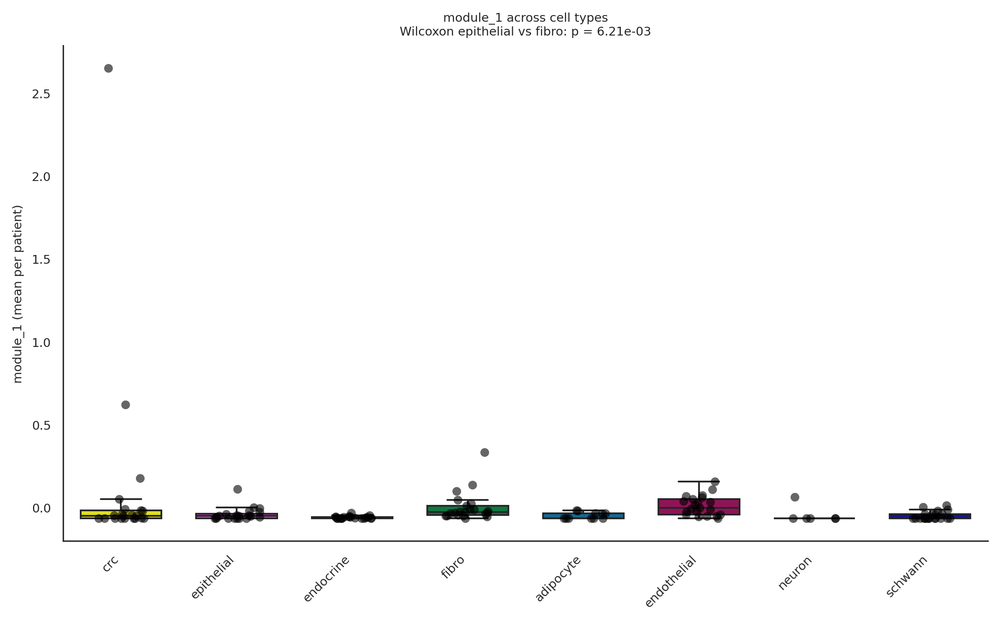

module_1: Wilcoxon W=27.000, p=6.210e-03  (n=20 paired patients)


/tmp/ipykernel_88/1112235445.py:40: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(
/tmp/ipykernel_88/1112235445.py:40: UserWarning: The palette list has more values (98) than needed (8), which may not be intended.
  ax = sns.boxplot(


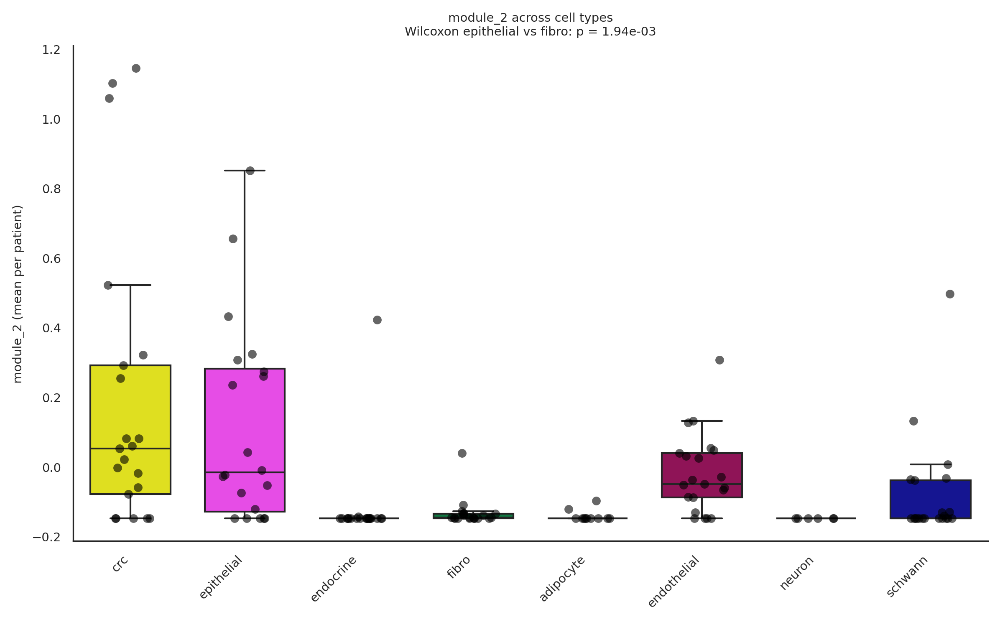

module_2: Wilcoxon W=18.000, p=1.944e-03  (n=20 paired patients)


/tmp/ipykernel_88/1112235445.py:40: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(
/tmp/ipykernel_88/1112235445.py:40: UserWarning: The palette list has more values (98) than needed (8), which may not be intended.
  ax = sns.boxplot(


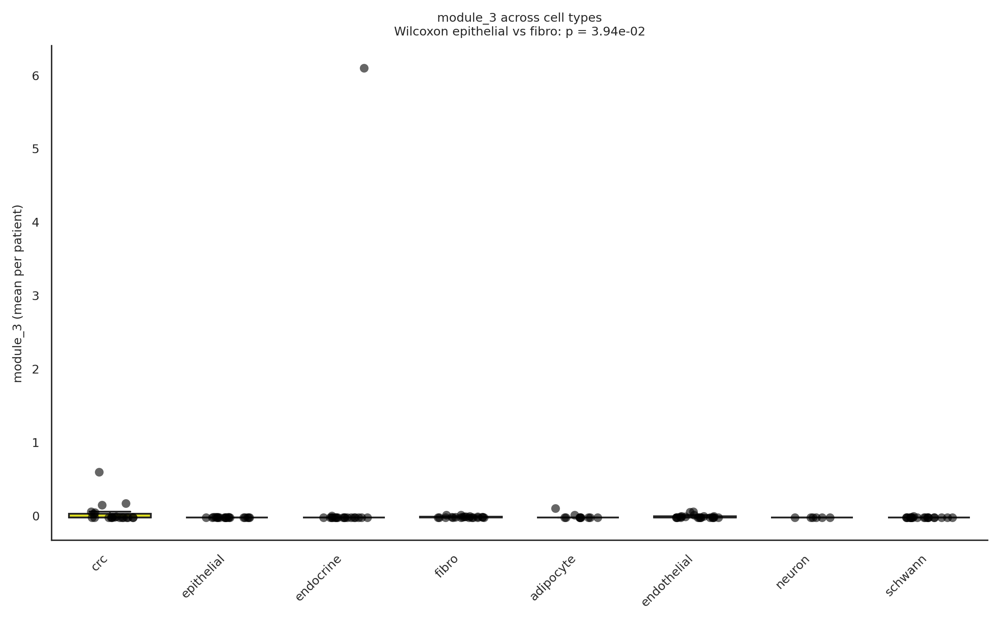

module_3: Wilcoxon W=33.000, p=3.936e-02  (n=20 paired patients)


/tmp/ipykernel_88/1112235445.py:40: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  ax = sns.boxplot(
/tmp/ipykernel_88/1112235445.py:40: UserWarning: The palette list has more values (98) than needed (8), which may not be intended.
  ax = sns.boxplot(


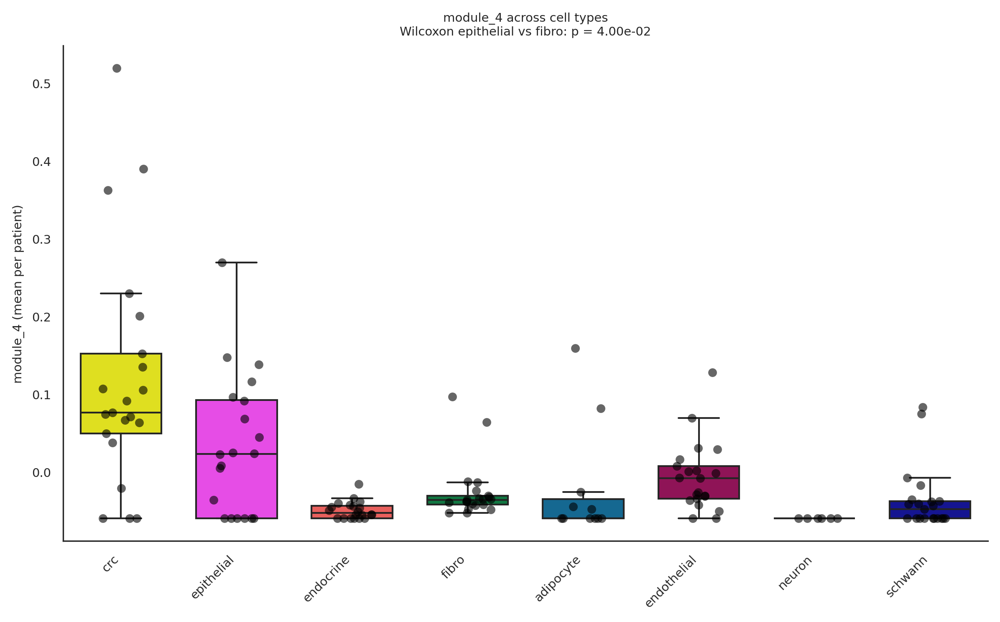

module_4: Wilcoxon W=50.000, p=3.999e-02  (n=20 paired patients)


In [23]:
import os
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from scipy.stats import wilcoxon

# Ensure output directory exists
os.makedirs(fig_save_path, exist_ok=True)

# Your modules and the full list of cell types
mods = ['module_1','module_2','module_3','module_4']
cell_types = [
    'crc', 'epithelial', 'endocrine', 'fibro',
    'adipocyte', 'endothelial', 'neuron', 'schwann'
]

# 1) Subset & aggregate per patient × cell type
df = (
    adata.obs[mods + ['pid','annotation_stroma']]
         .query("annotation_stroma in @cell_types")
)
agg = df.groupby(['pid','annotation_stroma'])[mods].mean().reset_index()

# Use clean white background
sns.set_style('white')

for mod in mods:
    # 2) Prepare long‐form for plotting
    plot_df = agg[['pid','annotation_stroma', mod]].rename(columns={mod: 'score'})

    # 3) Compute paired Wilcoxon for epithelial vs fibro
    pivot = (
        agg.pivot(index='pid', columns='annotation_stroma', values=mod)
           .dropna(subset=['epithelial','fibro'])
    )
    stat, p = wilcoxon(pivot['epithelial'], pivot['fibro'])

    # 4) Plot
    plt.figure(figsize=(8,5))
    ax = sns.boxplot(
        data=plot_df,
        x='annotation_stroma', y='score',
        order=cell_types,
        showfliers=False,
        width=0.7,
        palette=color_map_clusters_nogrey
    )
    sns.stripplot(
        data=plot_df,
        x='annotation_stroma', y='score',
        order=cell_types,
        jitter=0.2, size=5,
        color='black', alpha=0.6
    )
    ax.set_xlabel('')
    ax.set_ylabel(f'{mod} (mean per patient)')
    ax.set_title(f'{mod} across cell types\n'
                 f'Wilcoxon epithelial vs fibro: p = {p:.2e}')
    sns.despine(top=True, right=True)
    plt.xticks(rotation=45, ha='right')
    plt.tight_layout()

    # 5) Save and show
    outpath = os.path.join(fig_save_path, f"{mod}_all_celltypes.svg")
    outpath_csv = os.path.join(fig_save_path, f"{mod}_all_celltypes.csv")
    plt.savefig(outpath, format='svg')
    wide_df = (
    plot_df.pivot(index="pid", 
                  columns="annotation_stroma", 
                  values="score")
            .reset_index()
    )
    wide_df.to_csv(outpath_csv)
    plt.show()
    plt.close()
    
    # 6) Print detailed stats
    print(f"{mod}: Wilcoxon W={stat:.3f}, p={p:.3e}  (n={pivot.shape[0]} paired patients)")


# infer cnv

In [7]:
import infercnvpy as cnv
adata_path = DATA_DIR + 'TIL-X-PAAD-X-snRNAseq-X-2022-X-Hwang-X-10.1038_s41588-022-01134-8-X-all_cells_Milo_annotated_compressed.h5ad'


In [8]:
adata = sc.read(adata_path)

In [9]:
adata

AnnData object with n_obs × n_vars = 207661 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'pid', 'total_counts', 'percent_mito', 'batch', 'broad_celltypes', 'treatment_status', 'celltypes', 'new_celltypes', 'Level 1 Annotation', 'Level 2 Annotation', 'Level 3 Annotation', 'new_treatment', 'response', 'pretreated', 'pretreatment_CTX', 'SEACell', 'annotation', 'pheno_annotate'
    uns: 'leiden', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [10]:
genes = list(adata.var_names)

In [11]:
from biomart import BiomartServer
import pandas as pd
from io import StringIO
import time

# Connect to Ensembl BioMart
server = BiomartServer("http://www.ensembl.org/biomart")
dataset = server.datasets['hsapiens_gene_ensembl']

# Convert to list (if AnnDataIndex)
gene_list = list(adata.var_names)

# Prepare results container
all_results = []

# Batch size (Ensembl may reject huge queries)
batch_size = 300

# Loop in batches
for i in range(0, len(gene_list), batch_size):
    batch = gene_list[i:i+batch_size]
    try:
        response = dataset.search({
            'filters': {
                'external_gene_name': batch
            },
            'attributes': [
                'external_gene_name', 'chromosome_name', 'start_position', 'end_position'
            ]
        })
        text = "\n".join(line.decode("utf-8") for line in response.iter_lines())
        batch_df = pd.read_csv(StringIO(text), sep="\t", header=None)
        batch_df.columns = ["gene", "chromosome", "start", "end"]
        all_results.append(batch_df)
    except Exception as e:
        print(f"Batch {i}-{i+batch_size} failed: {e}")
    time.sleep(0.5)  # polite delay

# Combine all results
positions = pd.concat(all_results, ignore_index=True)
positions

,gene,chromosome,start,end
0,PRAMEF11,HG1342_HG2282_PATCH,6118,12923
1,HNRNPCL1,HG1342_HG2282_PATCH,28921,30238
2,PRAMEF2,HG1342_HG2282_PATCH,38599,43422
3,PRAMEF4,HG1342_HG2282_PATCH,60725,67714
4,PRAMEF10,HG1342_HG2282_PATCH,74409,79783
...,...,...,...,...
23988,SPATC1L,HSCHR21_5_CTG2,20585,45846
23989,GART,HSCHR21_4_CTG1_1,102653,115588
23990,DNAJC28,HSCHR21_4_CTG1_1,89659,95850
23991,IFNGR2,HSCHR21_4_CTG1_1,5408,83477


In [12]:
positions.set_index("gene", inplace=True)
positions

,chromosome,start,end
gene,,,
PRAMEF11,HG1342_HG2282_PATCH,6118,12923
HNRNPCL1,HG1342_HG2282_PATCH,28921,30238
PRAMEF2,HG1342_HG2282_PATCH,38599,43422
PRAMEF4,HG1342_HG2282_PATCH,60725,67714
PRAMEF10,HG1342_HG2282_PATCH,74409,79783
...,...,...,...
SPATC1L,HSCHR21_5_CTG2,20585,45846
GART,HSCHR21_4_CTG1_1,102653,115588
DNAJC28,HSCHR21_4_CTG1_1,89659,95850


In [13]:
#filter to standard chromosomes
standard_chroms = [str(i) for i in range(1, 23)] + ['X', 'Y', 'MT']
positions = positions[positions['chromosome'].isin(standard_chroms)]
positions

,chromosome,start,end
gene,,,
PRDM16,1,3069168,3438621
PEX10,1,2403964,2413797
PEX14,1,10472288,10630758
PLCH2,1,2425980,2505532
SPSB1,1,9292894,9369532
...,...,...,...
BACE2-IT1,21,41180097,41180626
C21orf140,21,34400112,34401072
KRTAP6-3,21,30592440,30593055


In [14]:
duplicate_genes = positions.index[positions.index.duplicated(keep=False)].unique()
duplicate_genes

Index(['LINC00970', 'LINC01115', 'MALL', 'LINC01618', 'C4orf36', 'HERC3',
       'PDE8B', 'CAST', 'MATR3', 'RAET1E-AS1', 'POLR2J3', 'PPP2R3B', 'IL3RA',
       'P2RY8', 'SLC25A6', 'DHRSX', 'ASMTL', 'LINC00685', 'PLCXD1', 'ZBED1',
       'LINC00102', 'CD99', 'SHOX', 'CRLF2', 'AKAP17A', 'ASMT', 'CSF2RA',
       'ASMTL-AS1', 'LINC00106', 'GTPBP6', 'VENTXP1', 'NXF5', 'VAMP7',
       'WASIR1', 'IL9R', 'KBTBD11-OT1', 'PINX1', 'FAM95B1', 'BMS1P14',
       'SPATA13', 'SFTA3', 'GOLGA8M', 'ZNF286B', 'CCDC144NL', 'TRIM16L',
       'PDE4C', 'ZNF781', 'SIGLEC5', 'BIRC8', 'TTTY11', 'ELFN2'],
      dtype='object', name='gene')

In [15]:
#remove true duplicates keeping the longest gene
positions["length"] = positions["end"] - positions["start"]
positions = positions.sort_values("length", ascending=False)
positions = positions[~positions.index.duplicated(keep="first")]
positions.drop(columns="length", inplace=True)

/tmp/ipykernel_366/2839657198.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  positions["length"] = positions["end"] - positions["start"]


In [16]:
duplicate_genes = positions.index[positions.index.duplicated(keep=False)].unique()
duplicate_genes

Index([], dtype='object', name='gene')

In [17]:
adata.var['chromosome'] = positions['chromosome']
adata.var['start'] = positions['start']
adata.var['end'] = positions['end']


In [18]:
#less granular annotations

mapping_dict = {'B':'B',
 'B-memory-DN':'B',
 'B-naive':'B',
 'B_proliferating':'B',
 'CD4-T-naive':'CD4-T',
 'CD4-TSCM_TFH':'CD4-T',
 'CD56bright-NK':'CD56bright-NK',
 'CD56dim-NK':'CD56dim-NK',
 'CD8-T':'CD8-T',
 'CD8-TRM':'CD8-T',
 'CD8-T_KLRG1pos-effector':'CD8-T',
 'GC-B':'B',
 'Mac':'Mac',
 'NK':'NK',
 'PV-Mac':'Mac',
 'T':'T',
 'T_proliferating':'T',
 'Treg':'Treg',
 'all_ADM':'epithelial',
 'all_Acinar':'epithelial',
 'all_Acinar (REG+)':'epithelial',
 'all_Adipocyte':'adipocyte',
 'all_Alpha':'endocrine',
 'all_Beta':'endocrine',
 'all_CAF':'(myo)fibroblast',
 'all_Delta':'endocrine',
 'all_Ductal':'epithelial',
 'all_Ductal (atypical)': 'epithelial',
 'all_Epsilon':'endocrine',
 'all_Gamma':'endocrine',
 'all_Hormone-negative neuroendocrine':'neuroendocrine',
 'all_Intra-pancreatic neurons':'neuron',
 'all_Lymphatic':'endo',
 'all_Malignant':'crc-carcinoma-cell',
 'all_Pericyte':'fibroblast',
 'all_Schwann':'schwann',
 'all_Vascular':'endo',
 'all_Vascular smooth muscle':'(myo)fibroblast',
 'all_myCAF':'(myo)fibroblast',
 'c-mono':'mono',
 'cDC1':'DC',
 'cDC2':'DC',
 'cDC3':'DC',
 'gran':'gran',
 'mast':'mast',
 'nc-mono':'mono',
 'p-DC':'DC',
 'plasma':'plasma'}

In [19]:
adata.obs['annotation_merged']= adata.obs['annotation'].map(mapping_dict)
adata.obs['annotation_merged'].value_counts()

annotation_merged
crc-carcinoma-cell    63861
(myo)fibroblast       55622
epithelial            29388
endo                  16201
fibroblast            11474
Mac                    9648
endocrine              7139
CD8-T                  3405
CD4-T                  1831
schwann                1714
neuroendocrine         1599
T                      1246
B                      1241
Treg                    533
adipocyte               530
DC                      464
mono                    459
mast                    263
NK                      164
plasma                  112
CD56bright-NK           104
gran                     98
CD56dim-NK               74
neuron                   25
Name: count, dtype: int64

In [20]:
map_dict = {'(myo)fibroblast':'fibro',
 'B':'leuko',
 'CD4-T':'leuko',
 'CD56bright-NK':'leuko',
 'CD56dim-NK':'leuko',
 'CD8-T':'leuko',
 'DC':'leuko',
 'Mac':'leuko',
 'NK':'leuko',
 'Treg':'leuko',
 'adipocyte':'adipocyte',
 'crc-carcinoma-cell':'crc',
 'endo':'endothelial',
 'endocrine':'endocrine',
 'epithelial':'epithelial',
 'fibroblast':'fibro',
 'gran':'leuko',
 'mast':'leuko',
 'mono':'leuko',
 'neuroendocrine':'endocrine',
 'neuron':'neuron',
 'plasma':'leuko',
 'schwann':'schwann'}

In [21]:
adata.obs['annotation_stroma'] = adata.obs['annotation_merged'].map(map_dict)
set(adata.obs['annotation_stroma'])

{'adipocyte',
 'crc',
 'endocrine',
 'endothelial',
 'epithelial',
 'fibro',
 'leuko',
 nan,
 'neuron',
 'schwann'}

In [22]:
adata = adata[~adata.obs['annotation_stroma'].isna()]
adata

View of AnnData object with n_obs × n_vars = 205949 × 22164
    obs: 'sampleid', 'n_genes', 'n_counts', 'pid', 'total_counts', 'percent_mito', 'batch', 'broad_celltypes', 'treatment_status', 'celltypes', 'new_celltypes', 'Level 1 Annotation', 'Level 2 Annotation', 'Level 3 Annotation', 'new_treatment', 'response', 'pretreated', 'pretreatment_CTX', 'SEACell', 'annotation', 'pheno_annotate', 'annotation_merged', 'annotation_stroma'
    var: 'chromosome', 'start', 'end'
    uns: 'leiden', 'neighbors', 'pca', 'tsne', 'umap'
    obsm: 'X_pca', 'X_tsne', 'X_umap'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

In [23]:
mapping_dict = {'adipocyte':'stroma',
 'crc':'crc',
 'endocrine':'epithelial',
 'endothelial':'stroma',
 'epithelial':'epithelial',
 'fibro':'stroma',
 'leuko':'leuko',
 'neuron':'stroma',
 'schwann':'stroma'}

In [24]:
adata.obs['annotation_stroma_collapsed'] = adata.obs['annotation_stroma'].map(mapping_dict)

/tmp/ipykernel_366/2717700035.py:1: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['annotation_stroma_collapsed'] = adata.obs['annotation_stroma'].map(mapping_dict)


In [26]:
# Drop genes with missing chromosome, start, or end
adata = adata[:, adata.var["chromosome"].notna() & 
                    adata.var["start"].notna() & 
                    adata.var["end"].notna()].copy()

In [28]:
#Drop missing genomic info
adata = adata[:, adata.var[["chromosome", "start", "end"]].notna().all(axis=1)].copy()

#Sort genes by chromosomal location
adata.var["start"] = adata.var["start"].astype(int)
adata = adata[:, adata.var.sort_values(["chromosome", "start"]).index].copy()

#Drop duplicate genes (keep only one per symbol)
adata = adata[:, ~adata.var.index.duplicated(keep="first")].copy()

#filter chromosomes with <10 genes
gene_counts = adata.var["chromosome"].value_counts()
valid_chroms = gene_counts[gene_counts >= 10].index
adata = adata[:, adata.var["chromosome"].isin(valid_chroms)].copy()

In [29]:
#Fix chromosome names
adata.var["chromosome"] = "chr" + adata.var["chromosome"].astype(str)

#Convert positions to numeric
adata.var["start"] = pd.to_numeric(adata.var["start"], errors="coerce")

#Drop invalid rows
valid_var = adata.var.dropna(subset=["start"]).drop_duplicates(subset=["chromosome", "start"])
adata = adata[:, valid_var.index]  # ← This slices both X and var

#Sort by chromosome and start
adata = adata[:, adata.var.sort_values(["chromosome", "start"]).index]

In [30]:
import infercnvpy as cnv
cnv.tl.infercnv(
    adata,
    reference_key="annotation_stroma_collapsed",
    reference_cat=["leuko"],
    window_size=101,
    step=20,
    dynamic_threshold=True,
    n_jobs=1,
    chunksize=500,
)


  0%|          | 0/412 [00:00<?, ?it/s]

/home/wallet/miniconda3/envs/2023_scanpy_base/lib/python3.10/site-packages/infercnvpy/tl/_infercnv.py:154: ImplicitModificationWarning: Setting element `.obsm['X_cnv']` of view, initializing view as actual.
  adata.obsm[f"X_{key_added}"] = res


In [32]:
adata

AnnData object with n_obs × n_vars = 205949 × 20145
    obs: 'sampleid', 'n_genes', 'n_counts', 'pid', 'total_counts', 'percent_mito', 'batch', 'broad_celltypes', 'treatment_status', 'celltypes', 'new_celltypes', 'Level 1 Annotation', 'Level 2 Annotation', 'Level 3 Annotation', 'new_treatment', 'response', 'pretreated', 'pretreatment_CTX', 'SEACell', 'annotation', 'pheno_annotate', 'annotation_merged', 'annotation_stroma', 'annotation_stroma_collapsed'
    var: 'chromosome', 'start', 'end'
    uns: 'leiden', 'neighbors', 'pca', 'tsne', 'umap', 'cnv'
    obsm: 'X_pca', 'X_tsne', 'X_umap', 'X_cnv'
    varm: 'PCs'
    layers: 'counts'
    obsp: 'connectivities', 'distances'

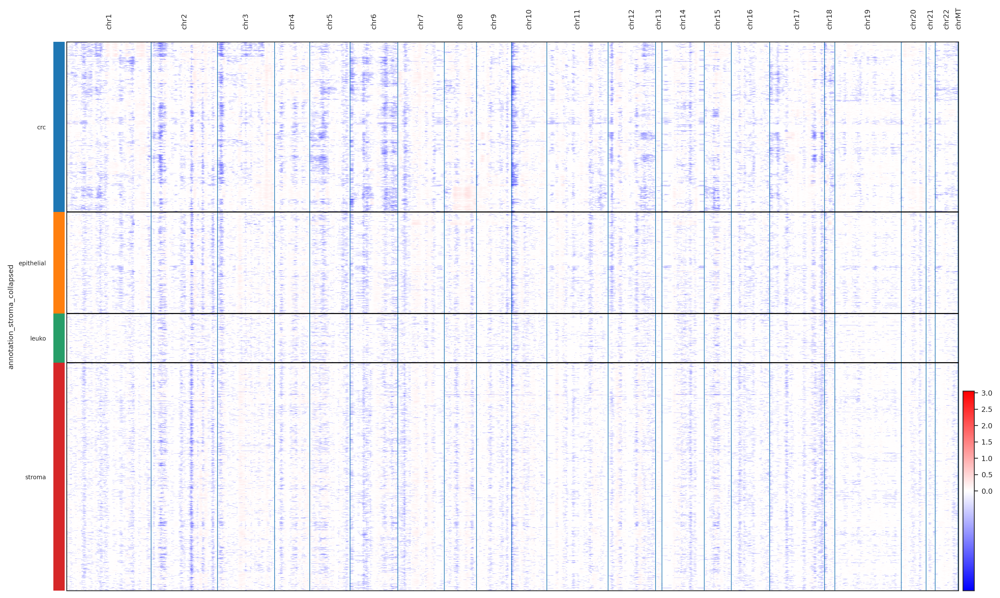

In [33]:
cnv.pl.chromosome_heatmap(adata, groupby="annotation_stroma_collapsed")

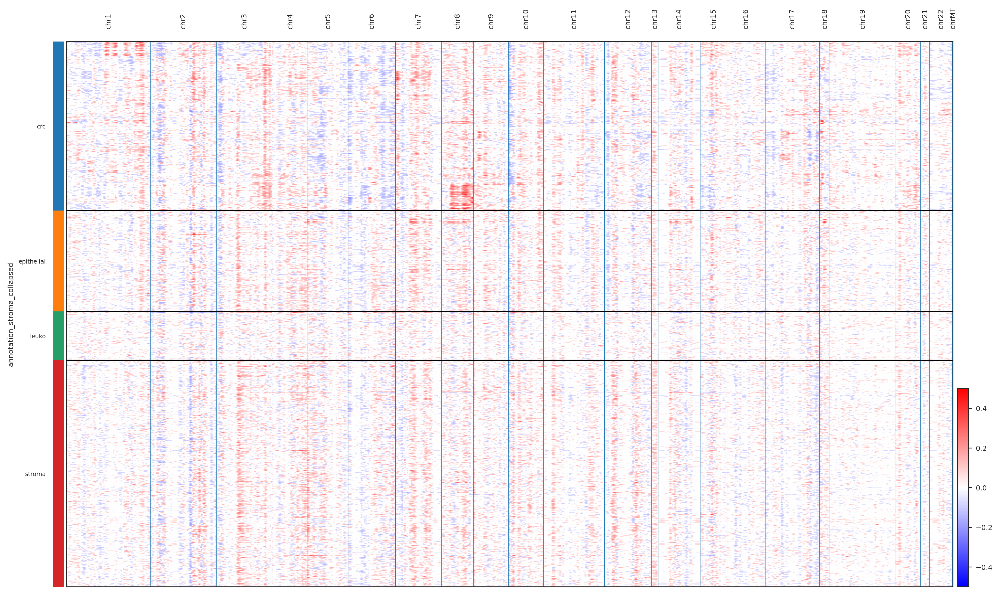

In [36]:
cnv.pl.chromosome_heatmap(
    adata,
    groupby="annotation_stroma_collapsed",
    vmin=-0.5,
    vmax=0.5
)